In [1]:
%matplotlib inline


DCGAN Tutorial
==============

**Author**: `Nathan Inkawhich <https://github.com/inkawhich>`__




Introduction
------------

This tutorial will give an introduction to DCGANs through an example. We
will train a generative adversarial network (GAN) to generate new
celebrities after showing it pictures of many real celebrities. Most of
the code here is from the dcgan implementation in
`pytorch/examples <https://github.com/pytorch/examples>`__, and this
document will give a thorough explanation of the implementation and shed
light on how and why this model works. But don’t worry, no prior
knowledge of GANs is required, but it may require a first-timer to spend
some time reasoning about what is actually happening under the hood.
Also, for the sake of time it will help to have a GPU, or two. Lets
start from the beginning.

Generative Adversarial Networks
-------------------------------

What is a GAN?
~~~~~~~~~~~~~~

GANs are a framework for teaching a DL model to capture the training
data’s distribution so we can generate new data from that same
distribution. GANs were invented by Ian Goodfellow in 2014 and first
described in the paper `Generative Adversarial
Nets <https://papers.nips.cc/paper/5423-generative-adversarial-nets.pdf>`__.
They are made of two distinct models, a *generator* and a
*discriminator*. The job of the generator is to spawn ‘fake’ images that
look like the training images. The job of the discriminator is to look
at an image and output whether or not it is a real training image or a
fake image from the generator. During training, the generator is
constantly trying to outsmart the discriminator by generating better and
better fakes, while the discriminator is working to become a better
detective and correctly classify the real and fake images. The
equilibrium of this game is when the generator is generating perfect
fakes that look as if they came directly from the training data, and the
discriminator is left to always guess at 50% confidence that the
generator output is real or fake.

Now, lets define some notation to be used throughout tutorial starting
with the discriminator. Let $x$ be data representing an image.
$D(x)$ is the discriminator network which outputs the (scalar)
probability that $x$ came from training data rather than the
generator. Here, since we are dealing with images the input to
$D(x)$ is an image of HWC size 3x64x64. Intuitively, $D(x)$
should be HIGH when $x$ comes from training data and LOW when
$x$ comes from the generator. $D(x)$ can also be thought of
as a traditional binary classifier.

For the generator’s notation, let $z$ be a latent space vector
sampled from a standard normal distribution. $G(z)$ represents the
generator function which maps the latent vector $z$ to data-space.
The goal of $G$ is to estimate the distribution that the training
data comes from ($p_{data}$) so it can generate fake samples from
that estimated distribution ($p_g$).

So, $D(G(z))$ is the probability (scalar) that the output of the
generator $G$ is a real image. As described in `Goodfellow’s
paper <https://papers.nips.cc/paper/5423-generative-adversarial-nets.pdf>`__,
$D$ and $G$ play a minimax game in which $D$ tries to
maximize the probability it correctly classifies reals and fakes
($logD(x)$), and $G$ tries to minimize the probability that
$D$ will predict its outputs are fake ($log(1-D(G(x)))$).
From the paper, the GAN loss function is

\begin{align}\underset{G}{\text{min}} \underset{D}{\text{max}}V(D,G) = \mathbb{E}_{x\sim p_{data}(x)}\big[logD(x)\big] + \mathbb{E}_{z\sim p_{z}(z)}\big[log(1-D(G(x)))\big]\end{align}

In theory, the solution to this minimax game is where
$p_g = p_{data}$, and the discriminator guesses randomly if the
inputs are real or fake. However, the convergence theory of GANs is
still being actively researched and in reality models do not always
train to this point.

What is a DCGAN?
~~~~~~~~~~~~~~~~

A DCGAN is a direct extension of the GAN described above, except that it
explicitly uses convolutional and convolutional-transpose layers in the
discriminator and generator, respectively. It was first described by
Radford et. al. in the paper `Unsupervised Representation Learning With
Deep Convolutional Generative Adversarial
Networks <https://arxiv.org/pdf/1511.06434.pdf>`__. The discriminator
is made up of strided
`convolution <https://pytorch.org/docs/stable/nn.html#torch.nn.Conv2d>`__
layers, `batch
norm <https://pytorch.org/docs/stable/nn.html#torch.nn.BatchNorm2d>`__
layers, and
`LeakyReLU <https://pytorch.org/docs/stable/nn.html#torch.nn.LeakyReLU>`__
activations. The input is a 3x64x64 input image and the output is a
scalar probability that the input is from the real data distribution.
The generator is comprised of
`convolutional-transpose <https://pytorch.org/docs/stable/nn.html#torch.nn.ConvTranspose2d>`__
layers, batch norm layers, and
`ReLU <https://pytorch.org/docs/stable/nn.html#relu>`__ activations. The
input is a latent vector, $z$, that is drawn from a standard
normal distribution and the output is a 3x64x64 RGB image. The strided
conv-transpose layers allow the latent vector to be transformed into a
volume with the same shape as an image. In the paper, the authors also
give some tips about how to setup the optimizers, how to calculate the
loss functions, and how to initialize the model weights, all of which
will be explained in the coming sections.




In [4]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

# Set random seem for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


Inputs
------

Let’s define some inputs for the run:

-  **dataroot** - the path to the root of the dataset folder. We will
   talk more about the dataset in the next section
-  **workers** - the number of worker threads for loading the data with
   the DataLoader
-  **batch_size** - the batch size used in training. The DCGAN paper
   uses a batch size of 128
-  **image_size** - the spatial size of the images used for training.
   This implementation defaults to 64x64. If another size is desired,
   the structures of D and G must be changed. See
   `here <https://github.com/pytorch/examples/issues/70>`__ for more
   details
-  **nc** - number of color channels in the input images. For color
   images this is 3
-  **nz** - length of latent vector
-  **ngf** - relates to the depth of feature maps carried through the
   generator
-  **ndf** - sets the depth of feature maps propagated through the
   discriminator
-  **num_epochs** - number of training epochs to run. Training for
   longer will probably lead to better results but will also take much
   longer
-  **lr** - learning rate for training. As described in the DCGAN paper,
   this number should be 0.0002
-  **beta1** - beta1 hyperparameter for Adam optimizers. As described in
   paper, this number should be 0.5
-  **ngpu** - number of GPUs available. If this is 0, code will run in
   CPU mode. If this number is greater than 0 it will run on that number
   of GPUs




In [3]:
#from PIL import Image
# Root directory for dataset
dataroot = "./"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 128

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 128

# Size of feature maps in discriminator
ndf = 32

# Number of training epochs
num_epochs = 100

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [4]:
dataroot

'./'

Data
----

In this tutorial we will use the `Celeb-A Faces
dataset <http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html>`__ which can
be downloaded at the linked site, or in `Google
Drive <https://drive.google.com/drive/folders/0B7EVK8r0v71pTUZsaXdaSnZBZzg>`__.
The dataset will download as a file named *img_align_celeba.zip*. Once
downloaded, create a directory named *celeba* and extract the zip file
into that directory. Then, set the *dataroot* input for this notebook to
the *celeba* directory you just created. The resulting directory
structure should be:

::

   /path/to/celeba
       -> img_align_celeba  
           -> 188242.jpg
           -> 173822.jpg
           -> 284702.jpg
           -> 537394.jpg
              ...

This is an important step because we will be using the ImageFolder
dataset class, which requires there to be subdirectories in the
dataset’s root folder. Now, we can create the dataset, create the
dataloader, set the device to run on, and finally visualize some of the
training data.




cuda:0


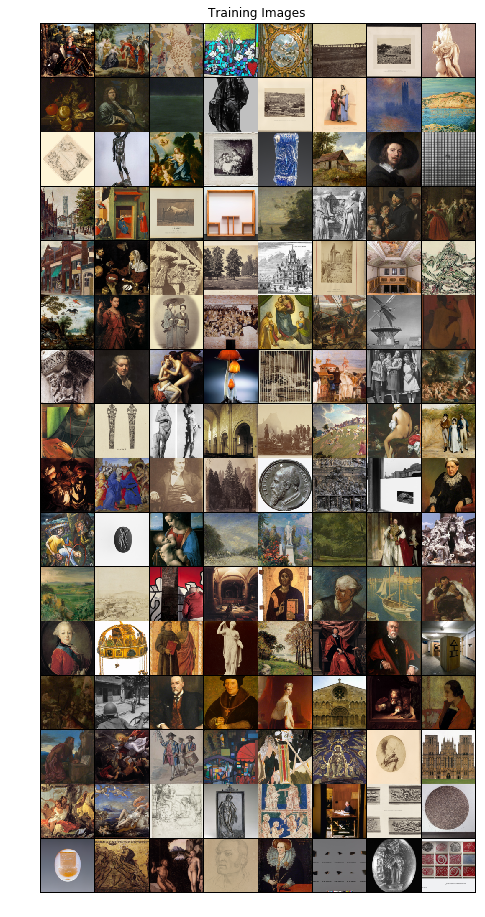

In [6]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

print(device)

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(16,16))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:128], padding=2, normalize=True).cpu(),(1,2,0)))

Implementation
--------------

With our input parameters set and the dataset prepared, we can now get
into the implementation. We will start with the weigth initialization
strategy, then talk about the generator, discriminator, loss functions,
and training loop in detail.

Weight Initialization
~~~~~~~~~~~~~~~~~~~~~

From the DCGAN paper, the authors specify that all model weights shall
be randomly initialized from a Normal distribution with mean=0,
stdev=0.2. The ``weights_init`` function takes an initialized model as
input and reinitializes all convolutional, convolutional-transpose, and
batch normalization layers to meet this criteria. This function is
applied to the models immediately after initialization.




In [7]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

Generator
~~~~~~~~~

The generator, $G$, is designed to map the latent space vector
($z$) to data-space. Since our data are images, converting
$z$ to data-space means ultimately creating a RGB image with the
same size as the training images (i.e. 3x64x64). In practice, this is
accomplished through a series of strided two dimensional convolutional
transpose layers, each paired with a 2d batch norm layer and a relu
activation. The output of the generator is fed through a tanh function
to return it to the input data range of $[-1,1]$. It is worth
noting the existence of the batch norm functions after the
conv-transpose layers, as this is a critical contribution of the DCGAN
paper. These layers help with the flow of gradients during training. An
image of the generator from the DCGAN paper is shown below.

.. figure:: /_static/img/dcgan_generator.png
   :alt: dcgan_generator

Notice, the how the inputs we set in the input section (*nz*, *ngf*, and
*nc*) influence the generator architecture in code. *nz* is the length
of the z input vector, *ngf* relates to the size of the feature maps
that are propagated through the generator, and *nc* is the number of
channels in the output image (set to 3 for RGB images). Below is the
code for the generator.




In [8]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(     nz, ngf * 16, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 16),
            nn.ReLU(True),
            # state size. (ngf*16) x 4 x 4
            nn.ConvTranspose2d(ngf * 16, ngf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 8 x 8
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 16 x 16 
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 32 x 32
            nn.ConvTranspose2d(ngf * 2,     ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 64 x 64
            nn.ConvTranspose2d(    ngf,      nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 128 x 128
        )

    def forward(self, input):
        return self.main(input)

Now, we can instantiate the generator and apply the ``weights_init``
function. Check out the printed model to see how the generator object is
structured.




In [9]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 2048, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): ConvTranspose2d(2048, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace)
    (6): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace)
    (9): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace)
    (12): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): BatchNorm2d(128, eps=1

Discriminator
~~~~~~~~~~~~~

As mentioned, the discriminator, $D$, is a binary classification
network that takes an image as input and outputs a scalar probability
that the input image is real (as opposed to fake). Here, $D$ takes
a 3x64x64 input image, processes it through a series of Conv2d,
BatchNorm2d, and LeakyReLU layers, and outputs the final probability
through a Sigmoid activation function. This architecture can be extended
with more layers if necessary for the problem, but there is significance
to the use of the strided convolution, BatchNorm, and LeakyReLUs. The
DCGAN paper mentions it is a good practice to use strided convolution
rather than pooling to downsample because it lets the network learn its
own pooling function. Also batch norm and leaky relu functions promote
healthy gradient flow which is critical for the learning process of both
$G$ and $D$.




Discriminator Code



In [10]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 128 x 128
            nn.Conv2d(nc, ndf, 4, stride=2, padding=1, bias=False), 
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 64 x 64
            nn.Conv2d(ndf, ndf * 2, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 32 x 32
            nn.Conv2d(ndf * 2, ndf * 4, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 16 x 16 
            nn.Conv2d(ndf * 4, ndf * 8, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 8 x 8
            nn.Conv2d(ndf * 8, ndf * 16, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*16) x 4 x 4
            nn.Conv2d(ndf * 16, 1, 4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
            # state size. 1
        )

    def forward(self, input):
        return self.main(input)

Now, as with the generator, we can create the discriminator, apply the
``weights_init`` function, and print the model’s structure.




In [11]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))
    
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
    (2): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace)
    (5): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace)
    (8): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace)
    (11): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=Tr

Loss Functions and Optimizers
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

With $D$ and $G$ setup, we can specify how they learn
through the loss functions and optimizers. We will use the Binary Cross
Entropy loss
(`BCELoss <https://pytorch.org/docs/stable/nn.html#torch.nn.BCELoss>`__)
function which is defined in PyTorch as:

\begin{align}\ell(x, y) = L = \{l_1,\dots,l_N\}^\top, \quad l_n = - \left[ y_n \cdot \log x_n + (1 - y_n) \cdot \log (1 - x_n) \right]\end{align}

Notice how this function provides the calculation of both log components
in the objective function (i.e. $log(D(x))$ and
$log(1-D(G(z)))$). We can specify what part of the BCE equation to
use with the $y$ input. This is accomplished in the training loop
which is coming up soon, but it is important to understand how we can
choose which component we wish to calculate just by changing $y$
(i.e. GT labels).

Next, we define our real label as 1 and the fake label as 0. These
labels will be used when calculating the losses of $D$ and
$G$, and this is also the convention used in the original GAN
paper. Finally, we set up two separate optimizers, one for $D$ and
one for $G$. As specified in the DCGAN paper, both are Adam
optimizers with learning rate 0.0002 and Beta1 = 0.5. For keeping track
of the generator’s learning progression, we will generate a fixed batch
of latent vectors that are drawn from a Gaussian distribution
(i.e. fixed_noise) . In the training loop, we will periodically input
this fixed_noise into $G$, and over the iterations we will see
images form out of the noise.




In [12]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(128, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

Training
~~~~~~~~

Finally, now that we have all of the parts of the GAN framework defined,
we can train it. Be mindful that training GANs is somewhat of an art
form, as incorrect hyperparameter settings lead to mode collapse with
little explanation of what went wrong. Here, we will closely follow
Algorithm 1 from Goodfellow’s paper, while abiding by some of the best
practices shown in `ganhacks <https://github.com/soumith/ganhacks>`__.
Namely, we will “construct different mini-batches for real and fake”
images, and also adjust G’s objective function to maximize
$logD(G(z))$. Training is split up into two main parts. Part 1
updates the Discriminator and Part 2 updates the Generator.

**Part 1 - Train the Discriminator**

Recall, the goal of training the discriminator is to maximize the
probability of correctly classifying a given input as real or fake. In
terms of Goodfellow, we wish to “update the discriminator by ascending
its stochastic gradient”. Practically, we want to maximize
$log(D(x)) + log(1-D(G(z)))$. Due to the separate mini-batch
suggestion from ganhacks, we will calculate this in two steps. First, we
will construct a batch of real samples from the training set, forward
pass through $D$, calculate the loss ($log(D(x))$), then
calculate the gradients in a backward pass. Secondly, we will construct
a batch of fake samples with the current generator, forward pass this
batch through $D$, calculate the loss ($log(1-D(G(z)))$),
and *accumulate* the gradients with a backward pass. Now, with the
gradients accumulated from both the all-real and all-fake batches, we
call a step of the Discriminator’s optimizer.

**Part 2 - Train the Generator**

As stated in the original paper, we want to train the Generator by
minimizing $log(1-D(G(z)))$ in an effort to generate better fakes.
As mentioned, this was shown by Goodfellow to not provide sufficient
gradients, especially early in the learning process. As a fix, we
instead wish to maximize $log(D(G(z)))$. In the code we accomplish
this by: classifying the Generator output from Part 1 with the
Discriminator, computing G’s loss *using real labels as GT*, computing
G’s gradients in a backward pass, and finally updating G’s parameters
with an optimizer step. It may seem counter-intuitive to use the real
labels as GT labels for the loss function, but this allows us to use the
$log(x)$ part of the BCELoss (rather than the $log(1-x)$
part) which is exactly what we want.

Finally, we will do some statistic reporting and at the end of each
epoch we will push our fixed_noise batch through the generator to
visually track the progress of G’s training. The training statistics
reported are:

-  **Loss_D** - discriminator loss calculated as the sum of losses for
   the all real and all fake batches ($log(D(x)) + log(D(G(z)))$).
-  **Loss_G** - generator loss calculated as $log(D(G(z)))$
-  **D(x)** - the average output (across the batch) of the discriminator
   for the all real batch. This should start close to 1 then
   theoretically converge to 0.5 when G gets better. Think about why
   this is.
-  **D(G(z))** - average discriminator outputs for the all fake batch.
   The first number is before D is updated and the second number is
   after D is updated. These numbers should start near 0 and converge to
   0.5 as G gets better. Think about why this is.

**Note:** This step might take a while, depending on how many epochs you
run and if you removed some data from the dataset.




In [13]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1

Starting Training Loop...
[0/100][0/646]	Loss_D: 1.8521	Loss_G: 6.3587	D(x): 0.5542	D(G(z)): 0.6277 / 0.0027
[0/100][50/646]	Loss_D: 1.9859	Loss_G: 6.4886	D(x): 0.4696	D(G(z)): 0.5088 / 0.0022
[0/100][100/646]	Loss_D: 1.6843	Loss_G: 1.1927	D(x): 0.5038	D(G(z)): 0.5858 / 0.3262
[0/100][150/646]	Loss_D: 1.4704	Loss_G: 0.8903	D(x): 0.5214	D(G(z)): 0.5145 / 0.4338
[0/100][200/646]	Loss_D: 1.7446	Loss_G: 0.8736	D(x): 0.3948	D(G(z)): 0.5193 / 0.4265
[0/100][250/646]	Loss_D: 1.4084	Loss_G: 0.9621	D(x): 0.5257	D(G(z)): 0.5068 / 0.4016
[0/100][300/646]	Loss_D: 1.4368	Loss_G: 0.9871	D(x): 0.5178	D(G(z)): 0.4943 / 0.4058
[0/100][350/646]	Loss_D: 0.9605	Loss_G: 1.8289	D(x): 0.6511	D(G(z)): 0.3835 / 0.1766


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[0/100][400/646]	Loss_D: 0.7948	Loss_G: 2.7790	D(x): 0.7345	D(G(z)): 0.3225 / 0.0940
[0/100][450/646]	Loss_D: 1.2430	Loss_G: 1.1455	D(x): 0.6211	D(G(z)): 0.4792 / 0.3459
[0/100][500/646]	Loss_D: 1.1335	Loss_G: 1.4525	D(x): 0.5660	D(G(z)): 0.3779 / 0.2524
[0/100][550/646]	Loss_D: 0.6454	Loss_G: 2.3570	D(x): 0.7478	D(G(z)): 0.2542 / 0.1111
[0/100][600/646]	Loss_D: 0.6622	Loss_G: 3.1130	D(x): 0.7926	D(G(z)): 0.2967 / 0.0621
[1/100][0/646]	Loss_D: 1.8916	Loss_G: 0.9801	D(x): 0.2420	D(G(z)): 0.1081 / 0.4231
[1/100][50/646]	Loss_D: 0.9481	Loss_G: 2.6419	D(x): 0.5984	D(G(z)): 0.2070 / 0.1377


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[1/100][100/646]	Loss_D: 0.6191	Loss_G: 2.1169	D(x): 0.6799	D(G(z)): 0.1720 / 0.1521
[1/100][150/646]	Loss_D: 0.4312	Loss_G: 2.8388	D(x): 0.8157	D(G(z)): 0.1478 / 0.1161
[1/100][200/646]	Loss_D: 1.5999	Loss_G: 1.2785	D(x): 0.2976	D(G(z)): 0.1207 / 0.3241
[1/100][250/646]	Loss_D: 1.3015	Loss_G: 1.4981	D(x): 0.5651	D(G(z)): 0.4031 / 0.2614
[1/100][300/646]	Loss_D: 1.2462	Loss_G: 1.1077	D(x): 0.5405	D(G(z)): 0.3784 / 0.3751
[1/100][350/646]	Loss_D: 0.8983	Loss_G: 0.8310	D(x): 0.6448	D(G(z)): 0.3035 / 0.4620
[1/100][400/646]	Loss_D: 0.8569	Loss_G: 2.0051	D(x): 0.5952	D(G(z)): 0.2409 / 0.1574
[1/100][450/646]	Loss_D: 1.0276	Loss_G: 1.3698	D(x): 0.5412	D(G(z)): 0.2604 / 0.3082
[1/100][500/646]	Loss_D: 1.0254	Loss_G: 1.8841	D(x): 0.6640	D(G(z)): 0.4140 / 0.1878
[1/100][550/646]	Loss_D: 0.7339	Loss_G: 2.0851	D(x): 0.6854	D(G(z)): 0.2630 / 0.1406
[1/100][600/646]	Loss_D: 0.9415	Loss_G: 1.7279	D(x): 0.5573	D(G(z)): 0.2504 / 0.2076
[2/100][0/646]	Loss_D: 0.6329	Loss_G: 3.0457	D(x): 0.8598	D(G(z))

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[2/100][50/646]	Loss_D: 1.0728	Loss_G: 1.4048	D(x): 0.5637	D(G(z)): 0.3339 / 0.2740
[2/100][100/646]	Loss_D: 1.0953	Loss_G: 1.3676	D(x): 0.5631	D(G(z)): 0.3439 / 0.2861
[2/100][150/646]	Loss_D: 1.1910	Loss_G: 1.4606	D(x): 0.5972	D(G(z)): 0.4067 / 0.2696
[2/100][200/646]	Loss_D: 1.3274	Loss_G: 1.9572	D(x): 0.5217	D(G(z)): 0.3527 / 0.2058
[2/100][250/646]	Loss_D: 1.2425	Loss_G: 2.0433	D(x): 0.3889	D(G(z)): 0.0819 / 0.1635
[2/100][300/646]	Loss_D: 0.7470	Loss_G: 3.4508	D(x): 0.7314	D(G(z)): 0.3012 / 0.0458
[2/100][350/646]	Loss_D: 0.5823	Loss_G: 2.5562	D(x): 0.7899	D(G(z)): 0.2668 / 0.0981
[2/100][400/646]	Loss_D: 1.5992	Loss_G: 1.5287	D(x): 0.5895	D(G(z)): 0.5225 / 0.2830
[2/100][450/646]	Loss_D: 1.1861	Loss_G: 1.1706	D(x): 0.5560	D(G(z)): 0.3760 / 0.3485
[2/100][500/646]	Loss_D: 1.3812	Loss_G: 1.5016	D(x): 0.5786	D(G(z)): 0.5000 / 0.2602
[2/100][550/646]	Loss_D: 1.3693	Loss_G: 1.0515	D(x): 0.4213	D(G(z)): 0.2997 / 0.3842
[2/100][600/646]	Loss_D: 1.3331	Loss_G: 1.4966	D(x): 0.5778	D(G(z)

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[3/100][500/646]	Loss_D: 1.0826	Loss_G: 1.5519	D(x): 0.6062	D(G(z)): 0.3990 / 0.2479
[3/100][550/646]	Loss_D: 1.4040	Loss_G: 1.0460	D(x): 0.3841	D(G(z)): 0.2747 / 0.3779
[3/100][600/646]	Loss_D: 1.3430	Loss_G: 1.2084	D(x): 0.5294	D(G(z)): 0.4378 / 0.3418
[4/100][0/646]	Loss_D: 1.4163	Loss_G: 1.1068	D(x): 0.5258	D(G(z)): 0.4690 / 0.3604


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[4/100][50/646]	Loss_D: 1.1994	Loss_G: 1.5456	D(x): 0.6236	D(G(z)): 0.4753 / 0.2395
[4/100][100/646]	Loss_D: 1.3326	Loss_G: 1.5049	D(x): 0.6324	D(G(z)): 0.5397 / 0.2513
[4/100][150/646]	Loss_D: 1.4984	Loss_G: 0.8290	D(x): 0.3951	D(G(z)): 0.3679 / 0.4616
[4/100][200/646]	Loss_D: 1.1440	Loss_G: 1.1000	D(x): 0.5540	D(G(z)): 0.3761 / 0.3636
[4/100][250/646]	Loss_D: 1.4557	Loss_G: 1.8401	D(x): 0.6729	D(G(z)): 0.6211 / 0.1796
[4/100][300/646]	Loss_D: 1.2553	Loss_G: 0.9996	D(x): 0.5107	D(G(z)): 0.3759 / 0.4058
[4/100][350/646]	Loss_D: 1.4356	Loss_G: 1.1316	D(x): 0.5442	D(G(z)): 0.5043 / 0.3550
[4/100][400/646]	Loss_D: 1.3016	Loss_G: 1.5528	D(x): 0.4843	D(G(z)): 0.3838 / 0.2419
[4/100][450/646]	Loss_D: 1.4257	Loss_G: 1.0920	D(x): 0.4400	D(G(z)): 0.3684 / 0.3737
[4/100][500/646]	Loss_D: 1.2805	Loss_G: 1.0675	D(x): 0.4209	D(G(z)): 0.2701 / 0.3799
[4/100][550/646]	Loss_D: 1.2995	Loss_G: 0.9452	D(x): 0.5015	D(G(z)): 0.4019 / 0.4196
[4/100][600/646]	Loss_D: 1.0908	Loss_G: 1.4149	D(x): 0.6000	D(G(z)

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[5/100][200/646]	Loss_D: 1.1558	Loss_G: 1.7318	D(x): 0.6834	D(G(z)): 0.5085 / 0.2065
[5/100][250/646]	Loss_D: 0.9246	Loss_G: 1.5185	D(x): 0.6408	D(G(z)): 0.3350 / 0.2384
[5/100][300/646]	Loss_D: 1.2049	Loss_G: 1.3747	D(x): 0.6313	D(G(z)): 0.4829 / 0.2827
[5/100][350/646]	Loss_D: 1.3706	Loss_G: 1.7176	D(x): 0.5556	D(G(z)): 0.4783 / 0.2073
[5/100][400/646]	Loss_D: 1.3095	Loss_G: 1.5183	D(x): 0.6090	D(G(z)): 0.4994 / 0.2520
[5/100][450/646]	Loss_D: 1.0329	Loss_G: 1.3626	D(x): 0.5713	D(G(z)): 0.3291 / 0.2896
[5/100][500/646]	Loss_D: 1.3058	Loss_G: 0.8680	D(x): 0.4230	D(G(z)): 0.3008 / 0.4480
[5/100][550/646]	Loss_D: 1.2505	Loss_G: 1.0220	D(x): 0.4137	D(G(z)): 0.2190 / 0.3995
[5/100][600/646]	Loss_D: 0.8738	Loss_G: 1.6868	D(x): 0.6086	D(G(z)): 0.2575 / 0.2184
[6/100][0/646]	Loss_D: 1.3108	Loss_G: 1.0793	D(x): 0.4445	D(G(z)): 0.3033 / 0.3726
[6/100][50/646]	Loss_D: 1.0897	Loss_G: 1.5437	D(x): 0.5330	D(G(z)): 0.2977 / 0.2486
[6/100][100/646]	Loss_D: 1.3331	Loss_G: 1.2427	D(x): 0.4514	D(G(z)):

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[6/100][250/646]	Loss_D: 1.3018	Loss_G: 1.1632	D(x): 0.4709	D(G(z)): 0.3285 / 0.3692
[6/100][300/646]	Loss_D: 1.0820	Loss_G: 1.5500	D(x): 0.6005	D(G(z)): 0.3881 / 0.2416
[6/100][350/646]	Loss_D: 0.9994	Loss_G: 1.4513	D(x): 0.5947	D(G(z)): 0.3329 / 0.2611
[6/100][400/646]	Loss_D: 1.2818	Loss_G: 1.9176	D(x): 0.5832	D(G(z)): 0.4737 / 0.1663
[6/100][450/646]	Loss_D: 1.1308	Loss_G: 1.5198	D(x): 0.5132	D(G(z)): 0.3061 / 0.2660
[6/100][500/646]	Loss_D: 1.1808	Loss_G: 1.4581	D(x): 0.4959	D(G(z)): 0.3042 / 0.2665
[6/100][550/646]	Loss_D: 1.0953	Loss_G: 2.2507	D(x): 0.7317	D(G(z)): 0.4999 / 0.1273
[6/100][600/646]	Loss_D: 0.9719	Loss_G: 1.8409	D(x): 0.7495	D(G(z)): 0.4579 / 0.1892
[7/100][0/646]	Loss_D: 1.0838	Loss_G: 2.5298	D(x): 0.7922	D(G(z)): 0.5345 / 0.0931
[7/100][50/646]	Loss_D: 1.0945	Loss_G: 1.7245	D(x): 0.7201	D(G(z)): 0.4836 / 0.2155
[7/100][100/646]	Loss_D: 1.1886	Loss_G: 0.7391	D(x): 0.4033	D(G(z)): 0.1510 / 0.5105
[7/100][150/646]	Loss_D: 1.1170	Loss_G: 1.8206	D(x): 0.5638	D(G(z)):

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[7/100][300/646]	Loss_D: 1.1819	Loss_G: 2.2220	D(x): 0.7772	D(G(z)): 0.5648 / 0.1384
[7/100][350/646]	Loss_D: 1.0936	Loss_G: 1.7058	D(x): 0.6593	D(G(z)): 0.4367 / 0.2116
[7/100][400/646]	Loss_D: 0.9144	Loss_G: 2.4653	D(x): 0.7496	D(G(z)): 0.4272 / 0.1081
[7/100][450/646]	Loss_D: 0.9822	Loss_G: 2.0844	D(x): 0.7506	D(G(z)): 0.4587 / 0.1549
[7/100][500/646]	Loss_D: 1.4605	Loss_G: 2.9983	D(x): 0.7419	D(G(z)): 0.6370 / 0.0627
[7/100][550/646]	Loss_D: 0.9773	Loss_G: 1.9588	D(x): 0.6919	D(G(z)): 0.4173 / 0.1648
[7/100][600/646]	Loss_D: 1.0576	Loss_G: 1.8070	D(x): 0.6040	D(G(z)): 0.3775 / 0.1883
[8/100][0/646]	Loss_D: 0.9707	Loss_G: 2.5854	D(x): 0.8556	D(G(z)): 0.5115 / 0.0908
[8/100][50/646]	Loss_D: 1.0915	Loss_G: 2.4175	D(x): 0.7309	D(G(z)): 0.4959 / 0.1059
[8/100][100/646]	Loss_D: 1.0544	Loss_G: 3.5816	D(x): 0.8218	D(G(z)): 0.5363 / 0.0361
[8/100][150/646]	Loss_D: 1.2212	Loss_G: 1.3268	D(x): 0.4967	D(G(z)): 0.3317 / 0.2919


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[8/100][200/646]	Loss_D: 0.9224	Loss_G: 2.1887	D(x): 0.6198	D(G(z)): 0.3141 / 0.1380
[8/100][250/646]	Loss_D: 1.2161	Loss_G: 1.2924	D(x): 0.4727	D(G(z)): 0.2998 / 0.3170
[8/100][300/646]	Loss_D: 0.9575	Loss_G: 1.5118	D(x): 0.5734	D(G(z)): 0.2705 / 0.2632
[8/100][350/646]	Loss_D: 1.1487	Loss_G: 1.4601	D(x): 0.6992	D(G(z)): 0.5045 / 0.2681
[8/100][400/646]	Loss_D: 1.0124	Loss_G: 2.3544	D(x): 0.7834	D(G(z)): 0.4961 / 0.1128
[8/100][450/646]	Loss_D: 0.8586	Loss_G: 1.9871	D(x): 0.7284	D(G(z)): 0.3781 / 0.1618
[8/100][500/646]	Loss_D: 1.2200	Loss_G: 1.3481	D(x): 0.4242	D(G(z)): 0.2075 / 0.2869
[8/100][550/646]	Loss_D: 0.8955	Loss_G: 1.7475	D(x): 0.5918	D(G(z)): 0.2531 / 0.2055
[8/100][600/646]	Loss_D: 1.3711	Loss_G: 0.9738	D(x): 0.3580	D(G(z)): 0.1993 / 0.4161
[9/100][0/646]	Loss_D: 1.0798	Loss_G: 2.0707	D(x): 0.7697	D(G(z)): 0.5157 / 0.1509
[9/100][50/646]	Loss_D: 1.1831	Loss_G: 1.1921	D(x): 0.4198	D(G(z)): 0.1771 / 0.3490
[9/100][100/646]	Loss_D: 0.9617	Loss_G: 1.7394	D(x): 0.5649	D(G(z)):

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[9/100][350/646]	Loss_D: 0.7372	Loss_G: 2.6754	D(x): 0.8021	D(G(z)): 0.3612 / 0.0901
[9/100][400/646]	Loss_D: 0.8779	Loss_G: 2.4265	D(x): 0.7965	D(G(z)): 0.4365 / 0.1087
[9/100][450/646]	Loss_D: 1.4089	Loss_G: 0.8414	D(x): 0.3290	D(G(z)): 0.1431 / 0.4589
[9/100][500/646]	Loss_D: 0.8984	Loss_G: 1.7437	D(x): 0.5289	D(G(z)): 0.1689 / 0.2122
[9/100][550/646]	Loss_D: 0.9645	Loss_G: 2.0633	D(x): 0.7239	D(G(z)): 0.4321 / 0.1554
[9/100][600/646]	Loss_D: 1.0503	Loss_G: 1.3525	D(x): 0.4804	D(G(z)): 0.2026 / 0.2951
[10/100][0/646]	Loss_D: 0.7252	Loss_G: 2.7189	D(x): 0.7710	D(G(z)): 0.3285 / 0.0859
[10/100][50/646]	Loss_D: 1.3640	Loss_G: 3.5426	D(x): 0.7291	D(G(z)): 0.5871 / 0.0369
[10/100][100/646]	Loss_D: 1.0263	Loss_G: 2.1451	D(x): 0.7241	D(G(z)): 0.4689 / 0.1357
[10/100][150/646]	Loss_D: 0.7693	Loss_G: 1.7368	D(x): 0.6407	D(G(z)): 0.2347 / 0.1992


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[10/100][200/646]	Loss_D: 0.8493	Loss_G: 2.0348	D(x): 0.6895	D(G(z)): 0.3406 / 0.1553
[10/100][250/646]	Loss_D: 0.6887	Loss_G: 2.3170	D(x): 0.7107	D(G(z)): 0.2558 / 0.1195
[10/100][300/646]	Loss_D: 1.4129	Loss_G: 2.4325	D(x): 0.7355	D(G(z)): 0.5702 / 0.1080
[10/100][350/646]	Loss_D: 1.0417	Loss_G: 2.9776	D(x): 0.8115	D(G(z)): 0.5266 / 0.0662
[10/100][400/646]	Loss_D: 0.8914	Loss_G: 1.7583	D(x): 0.5326	D(G(z)): 0.1695 / 0.2030
[10/100][450/646]	Loss_D: 0.8889	Loss_G: 1.8448	D(x): 0.6232	D(G(z)): 0.2796 / 0.1878
[10/100][500/646]	Loss_D: 1.3547	Loss_G: 1.4018	D(x): 0.5501	D(G(z)): 0.4744 / 0.2748
[10/100][550/646]	Loss_D: 1.0508	Loss_G: 1.3186	D(x): 0.5887	D(G(z)): 0.3514 / 0.2945
[10/100][600/646]	Loss_D: 1.1482	Loss_G: 3.1751	D(x): 0.8572	D(G(z)): 0.5821 / 0.0588
[11/100][0/646]	Loss_D: 0.8923	Loss_G: 2.7312	D(x): 0.8004	D(G(z)): 0.4588 / 0.0763
[11/100][50/646]	Loss_D: 1.0982	Loss_G: 2.8723	D(x): 0.8421	D(G(z)): 0.5594 / 0.0716
[11/100][100/646]	Loss_D: 1.0993	Loss_G: 2.2039	D(x): 0.6

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[11/100][200/646]	Loss_D: 0.6872	Loss_G: 2.4789	D(x): 0.7535	D(G(z)): 0.3041 / 0.0997
[11/100][250/646]	Loss_D: 0.9743	Loss_G: 1.6118	D(x): 0.5116	D(G(z)): 0.1949 / 0.2444
[11/100][300/646]	Loss_D: 1.3598	Loss_G: 1.1104	D(x): 0.3297	D(G(z)): 0.0715 / 0.3794
[11/100][350/646]	Loss_D: 0.8294	Loss_G: 1.9803	D(x): 0.5948	D(G(z)): 0.2102 / 0.1636
[11/100][400/646]	Loss_D: 0.8376	Loss_G: 2.9531	D(x): 0.7753	D(G(z)): 0.4126 / 0.0695
[11/100][450/646]	Loss_D: 1.2192	Loss_G: 2.6713	D(x): 0.7703	D(G(z)): 0.5643 / 0.0880
[11/100][500/646]	Loss_D: 0.8168	Loss_G: 1.7117	D(x): 0.7650	D(G(z)): 0.3803 / 0.2188
[11/100][550/646]	Loss_D: 0.8737	Loss_G: 2.8477	D(x): 0.7240	D(G(z)): 0.3837 / 0.0768
[11/100][600/646]	Loss_D: 1.3237	Loss_G: 4.0564	D(x): 0.9225	D(G(z)): 0.6649 / 0.0222
[12/100][0/646]	Loss_D: 1.0931	Loss_G: 1.0955	D(x): 0.5215	D(G(z)): 0.2560 / 0.3743
[12/100][50/646]	Loss_D: 0.9120	Loss_G: 3.0931	D(x): 0.8608	D(G(z)): 0.4996 / 0.0575
[12/100][100/646]	Loss_D: 1.1548	Loss_G: 3.2853	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[12/100][450/646]	Loss_D: 1.0897	Loss_G: 2.1548	D(x): 0.7140	D(G(z)): 0.4716 / 0.1415
[12/100][500/646]	Loss_D: 0.8121	Loss_G: 1.8973	D(x): 0.5463	D(G(z)): 0.1170 / 0.1886
[12/100][550/646]	Loss_D: 0.8563	Loss_G: 1.8312	D(x): 0.7340	D(G(z)): 0.3783 / 0.1888
[12/100][600/646]	Loss_D: 0.8659	Loss_G: 3.5728	D(x): 0.8961	D(G(z)): 0.4882 / 0.0399
[13/100][0/646]	Loss_D: 0.9077	Loss_G: 1.7769	D(x): 0.5063	D(G(z)): 0.0972 / 0.2164
[13/100][50/646]	Loss_D: 0.5759	Loss_G: 2.1020	D(x): 0.7169	D(G(z)): 0.1763 / 0.1551
[13/100][100/646]	Loss_D: 0.8128	Loss_G: 1.2425	D(x): 0.5864	D(G(z)): 0.1851 / 0.3282
[13/100][150/646]	Loss_D: 0.8176	Loss_G: 2.3571	D(x): 0.7268	D(G(z)): 0.3438 / 0.1222
[13/100][200/646]	Loss_D: 0.8575	Loss_G: 2.3607	D(x): 0.7206	D(G(z)): 0.3738 / 0.1216


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[13/100][250/646]	Loss_D: 1.1186	Loss_G: 1.0869	D(x): 0.4481	D(G(z)): 0.1812 / 0.3764
[13/100][300/646]	Loss_D: 0.9001	Loss_G: 1.8549	D(x): 0.6330	D(G(z)): 0.3028 / 0.1884
[13/100][350/646]	Loss_D: 0.7294	Loss_G: 2.9778	D(x): 0.8477	D(G(z)): 0.3871 / 0.0708
[13/100][400/646]	Loss_D: 1.6863	Loss_G: 4.6688	D(x): 0.9219	D(G(z)): 0.7549 / 0.0181
[13/100][450/646]	Loss_D: 0.8317	Loss_G: 1.9596	D(x): 0.7033	D(G(z)): 0.3399 / 0.1699
[13/100][500/646]	Loss_D: 1.0041	Loss_G: 2.8889	D(x): 0.8497	D(G(z)): 0.5230 / 0.0715
[13/100][550/646]	Loss_D: 0.7590	Loss_G: 1.5741	D(x): 0.6249	D(G(z)): 0.1954 / 0.2396
[13/100][600/646]	Loss_D: 0.8441	Loss_G: 2.2559	D(x): 0.6925	D(G(z)): 0.3301 / 0.1301
[14/100][0/646]	Loss_D: 0.8434	Loss_G: 1.9573	D(x): 0.7197	D(G(z)): 0.3515 / 0.1695
[14/100][50/646]	Loss_D: 0.8926	Loss_G: 3.2156	D(x): 0.8726	D(G(z)): 0.4823 / 0.0518
[14/100][100/646]	Loss_D: 0.7072	Loss_G: 1.6467	D(x): 0.6869	D(G(z)): 0.2393 / 0.2368
[14/100][150/646]	Loss_D: 0.8535	Loss_G: 1.5321	D(x): 0.6

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[14/100][500/646]	Loss_D: 0.8154	Loss_G: 1.9223	D(x): 0.5887	D(G(z)): 0.1724 / 0.1935
[14/100][550/646]	Loss_D: 0.7028	Loss_G: 1.8585	D(x): 0.5746	D(G(z)): 0.0886 / 0.1927
[14/100][600/646]	Loss_D: 0.9170	Loss_G: 1.2692	D(x): 0.5170	D(G(z)): 0.1492 / 0.3209
[15/100][0/646]	Loss_D: 0.9611	Loss_G: 1.2159	D(x): 0.4912	D(G(z)): 0.1556 / 0.3516


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[15/100][50/646]	Loss_D: 1.0683	Loss_G: 2.9751	D(x): 0.7719	D(G(z)): 0.4913 / 0.0731
[15/100][100/646]	Loss_D: 1.0197	Loss_G: 0.8995	D(x): 0.4871	D(G(z)): 0.1801 / 0.4534
[15/100][150/646]	Loss_D: 0.6647	Loss_G: 1.8912	D(x): 0.6280	D(G(z)): 0.1245 / 0.1888
[15/100][200/646]	Loss_D: 0.5972	Loss_G: 2.4992	D(x): 0.7869	D(G(z)): 0.2674 / 0.1040
[15/100][250/646]	Loss_D: 0.8450	Loss_G: 1.8236	D(x): 0.6880	D(G(z)): 0.3321 / 0.1883
[15/100][300/646]	Loss_D: 0.7842	Loss_G: 2.2950	D(x): 0.7560	D(G(z)): 0.3551 / 0.1321
[15/100][350/646]	Loss_D: 0.9590	Loss_G: 3.1133	D(x): 0.8833	D(G(z)): 0.5181 / 0.0639
[15/100][400/646]	Loss_D: 0.8290	Loss_G: 3.3447	D(x): 0.8953	D(G(z)): 0.4732 / 0.0463
[15/100][450/646]	Loss_D: 0.8605	Loss_G: 1.9950	D(x): 0.8009	D(G(z)): 0.4269 / 0.1656
[15/100][500/646]	Loss_D: 0.9341	Loss_G: 2.1844	D(x): 0.7590	D(G(z)): 0.4279 / 0.1400
[15/100][550/646]	Loss_D: 1.1078	Loss_G: 3.0964	D(x): 0.8154	D(G(z)): 0.5538 / 0.0588
[15/100][600/646]	Loss_D: 0.9738	Loss_G: 2.6557	D(x): 0

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[16/100][300/646]	Loss_D: 0.8044	Loss_G: 2.0070	D(x): 0.6554	D(G(z)): 0.2605 / 0.1665
[16/100][350/646]	Loss_D: 0.7878	Loss_G: 2.5581	D(x): 0.7628	D(G(z)): 0.3614 / 0.0996
[16/100][400/646]	Loss_D: 0.5986	Loss_G: 2.1558	D(x): 0.8269	D(G(z)): 0.2965 / 0.1460
[16/100][450/646]	Loss_D: 0.7540	Loss_G: 2.0714	D(x): 0.6369	D(G(z)): 0.2189 / 0.1535
[16/100][500/646]	Loss_D: 0.5378	Loss_G: 2.2288	D(x): 0.7718	D(G(z)): 0.2137 / 0.1413
[16/100][550/646]	Loss_D: 0.7047	Loss_G: 1.4240	D(x): 0.6232	D(G(z)): 0.1487 / 0.2973
[16/100][600/646]	Loss_D: 0.5639	Loss_G: 2.2870	D(x): 0.7780	D(G(z)): 0.2397 / 0.1287
[17/100][0/646]	Loss_D: 0.8631	Loss_G: 1.5127	D(x): 0.5757	D(G(z)): 0.2034 / 0.2616
[17/100][50/646]	Loss_D: 1.2834	Loss_G: 1.2123	D(x): 0.4410	D(G(z)): 0.2295 / 0.3565
[17/100][100/646]	Loss_D: 1.0172	Loss_G: 3.6131	D(x): 0.8269	D(G(z)): 0.5148 / 0.0373


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[17/100][150/646]	Loss_D: 0.8314	Loss_G: 1.0897	D(x): 0.6247	D(G(z)): 0.2342 / 0.3872
[17/100][200/646]	Loss_D: 0.8409	Loss_G: 3.3388	D(x): 0.9140	D(G(z)): 0.4889 / 0.0455
[17/100][250/646]	Loss_D: 0.6184	Loss_G: 2.4682	D(x): 0.7373	D(G(z)): 0.2360 / 0.1087
[17/100][300/646]	Loss_D: 0.8738	Loss_G: 2.1768	D(x): 0.7456	D(G(z)): 0.3651 / 0.1502
[17/100][350/646]	Loss_D: 0.8133	Loss_G: 1.4702	D(x): 0.5548	D(G(z)): 0.1365 / 0.2789
[17/100][400/646]	Loss_D: 0.8142	Loss_G: 2.7555	D(x): 0.8296	D(G(z)): 0.4161 / 0.0857
[17/100][450/646]	Loss_D: 0.6938	Loss_G: 1.4269	D(x): 0.6091	D(G(z)): 0.1215 / 0.2747
[17/100][500/646]	Loss_D: 0.6538	Loss_G: 2.0950	D(x): 0.6406	D(G(z)): 0.1391 / 0.1580
[17/100][550/646]	Loss_D: 0.9777	Loss_G: 1.8087	D(x): 0.4536	D(G(z)): 0.0753 / 0.2191
[17/100][600/646]	Loss_D: 0.7297	Loss_G: 1.9983	D(x): 0.7028	D(G(z)): 0.2719 / 0.1720
[18/100][0/646]	Loss_D: 0.9955	Loss_G: 1.0037	D(x): 0.4770	D(G(z)): 0.1444 / 0.4122
[18/100][50/646]	Loss_D: 0.3975	Loss_G: 3.3116	D(x): 0.8

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[18/100][400/646]	Loss_D: 0.6740	Loss_G: 2.7240	D(x): 0.8085	D(G(z)): 0.3276 / 0.0825
[18/100][450/646]	Loss_D: 0.7027	Loss_G: 1.4875	D(x): 0.5850	D(G(z)): 0.1035 / 0.2699
[18/100][500/646]	Loss_D: 1.2500	Loss_G: 4.1402	D(x): 0.9790	D(G(z)): 0.6546 / 0.0227
[18/100][550/646]	Loss_D: 0.6884	Loss_G: 1.6481	D(x): 0.7568	D(G(z)): 0.2996 / 0.2366
[18/100][600/646]	Loss_D: 0.9982	Loss_G: 0.9646	D(x): 0.5201	D(G(z)): 0.2084 / 0.4238
[19/100][0/646]	Loss_D: 1.1992	Loss_G: 4.2346	D(x): 0.9306	D(G(z)): 0.5923 / 0.0225
[19/100][50/646]	Loss_D: 0.6466	Loss_G: 1.9464	D(x): 0.7877	D(G(z)): 0.2988 / 0.1779
[19/100][100/646]	Loss_D: 0.3608	Loss_G: 2.8091	D(x): 0.9320	D(G(z)): 0.2353 / 0.0812


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[19/100][150/646]	Loss_D: 0.9798	Loss_G: 1.2576	D(x): 0.5000	D(G(z)): 0.1638 / 0.3311
[19/100][200/646]	Loss_D: 0.8254	Loss_G: 1.2086	D(x): 0.6304	D(G(z)): 0.2370 / 0.3290
[19/100][250/646]	Loss_D: 0.8028	Loss_G: 1.5402	D(x): 0.6210	D(G(z)): 0.2142 / 0.2549
[19/100][300/646]	Loss_D: 0.8437	Loss_G: 2.1724	D(x): 0.7637	D(G(z)): 0.3812 / 0.1469
[19/100][350/646]	Loss_D: 0.6456	Loss_G: 2.6969	D(x): 0.7484	D(G(z)): 0.2671 / 0.0943
[19/100][400/646]	Loss_D: 0.8344	Loss_G: 2.6433	D(x): 0.9022	D(G(z)): 0.4815 / 0.0929
[19/100][450/646]	Loss_D: 0.7045	Loss_G: 1.6681	D(x): 0.5898	D(G(z)): 0.1067 / 0.2331
[19/100][500/646]	Loss_D: 1.8395	Loss_G: 0.5036	D(x): 0.2954	D(G(z)): 0.1322 / 0.6858
[19/100][550/646]	Loss_D: 0.8004	Loss_G: 2.8622	D(x): 0.9105	D(G(z)): 0.4646 / 0.0751
[19/100][600/646]	Loss_D: 0.8913	Loss_G: 1.4457	D(x): 0.5555	D(G(z)): 0.1922 / 0.2846
[20/100][0/646]	Loss_D: 0.6007	Loss_G: 2.2807	D(x): 0.7236	D(G(z)): 0.2077 / 0.1344
[20/100][50/646]	Loss_D: 0.8379	Loss_G: 1.5526	D(x): 0.6

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[20/100][300/646]	Loss_D: 0.9534	Loss_G: 2.1175	D(x): 0.6356	D(G(z)): 0.3421 / 0.1525
[20/100][350/646]	Loss_D: 0.8836	Loss_G: 1.1032	D(x): 0.5463	D(G(z)): 0.1731 / 0.3773
[20/100][400/646]	Loss_D: 0.5232	Loss_G: 2.3066	D(x): 0.8152	D(G(z)): 0.2440 / 0.1334
[20/100][450/646]	Loss_D: 0.3018	Loss_G: 2.8544	D(x): 0.8534	D(G(z)): 0.1147 / 0.0783
[20/100][500/646]	Loss_D: 0.9339	Loss_G: 1.9958	D(x): 0.4656	D(G(z)): 0.0622 / 0.1727
[20/100][550/646]	Loss_D: 0.6076	Loss_G: 2.6521	D(x): 0.7913	D(G(z)): 0.2660 / 0.0975
[20/100][600/646]	Loss_D: 0.5593	Loss_G: 2.1847	D(x): 0.6803	D(G(z)): 0.1174 / 0.1483
[21/100][0/646]	Loss_D: 0.5981	Loss_G: 2.4387	D(x): 0.7474	D(G(z)): 0.2189 / 0.1134


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[21/100][50/646]	Loss_D: 0.7652	Loss_G: 3.0980	D(x): 0.9071	D(G(z)): 0.4424 / 0.0609
[21/100][100/646]	Loss_D: 0.5564	Loss_G: 2.5177	D(x): 0.7251	D(G(z)): 0.1707 / 0.1076
[21/100][150/646]	Loss_D: 0.7349	Loss_G: 2.1787	D(x): 0.8431	D(G(z)): 0.3949 / 0.1501
[21/100][200/646]	Loss_D: 0.5584	Loss_G: 3.2793	D(x): 0.8467	D(G(z)): 0.2959 / 0.0507
[21/100][250/646]	Loss_D: 0.5169	Loss_G: 3.0305	D(x): 0.9401	D(G(z)): 0.3386 / 0.0627
[21/100][300/646]	Loss_D: 0.7211	Loss_G: 3.3359	D(x): 0.8477	D(G(z)): 0.3812 / 0.0499
[21/100][350/646]	Loss_D: 0.6799	Loss_G: 2.8269	D(x): 0.7727	D(G(z)): 0.3004 / 0.0834
[21/100][400/646]	Loss_D: 0.7290	Loss_G: 3.5643	D(x): 0.9132	D(G(z)): 0.4292 / 0.0389
[21/100][450/646]	Loss_D: 0.6708	Loss_G: 2.2007	D(x): 0.5782	D(G(z)): 0.0643 / 0.1348
[21/100][500/646]	Loss_D: 1.0723	Loss_G: 1.3316	D(x): 0.4622	D(G(z)): 0.1447 / 0.3168
[21/100][550/646]	Loss_D: 0.8458	Loss_G: 3.4167	D(x): 0.7745	D(G(z)): 0.3942 / 0.0429
[21/100][600/646]	Loss_D: 0.4798	Loss_G: 3.0706	D(x): 0

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[22/100][100/646]	Loss_D: 2.1444	Loss_G: 1.0492	D(x): 0.1785	D(G(z)): 0.0154 / 0.4181
[22/100][150/646]	Loss_D: 0.7683	Loss_G: 1.4233	D(x): 0.5711	D(G(z)): 0.1127 / 0.2812
[22/100][200/646]	Loss_D: 0.9812	Loss_G: 1.7982	D(x): 0.7356	D(G(z)): 0.4460 / 0.2044
[22/100][250/646]	Loss_D: 0.9086	Loss_G: 4.4131	D(x): 0.9134	D(G(z)): 0.5040 / 0.0186
[22/100][300/646]	Loss_D: 1.1379	Loss_G: 3.5276	D(x): 0.8738	D(G(z)): 0.5700 / 0.0457
[22/100][350/646]	Loss_D: 0.6986	Loss_G: 2.8833	D(x): 0.8258	D(G(z)): 0.3367 / 0.0750
[22/100][400/646]	Loss_D: 0.8308	Loss_G: 1.8006	D(x): 0.5004	D(G(z)): 0.0557 / 0.2079
[22/100][450/646]	Loss_D: 0.6347	Loss_G: 2.1817	D(x): 0.7373	D(G(z)): 0.2353 / 0.1436
[22/100][500/646]	Loss_D: 0.3955	Loss_G: 3.2774	D(x): 0.7553	D(G(z)): 0.0874 / 0.0556
[22/100][550/646]	Loss_D: 0.5974	Loss_G: 2.2438	D(x): 0.7625	D(G(z)): 0.2347 / 0.1391
[22/100][600/646]	Loss_D: 0.8738	Loss_G: 1.1754	D(x): 0.5083	D(G(z)): 0.0953 / 0.3648
[23/100][0/646]	Loss_D: 0.9472	Loss_G: 3.0397	D(x): 0.

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[23/100][250/646]	Loss_D: 0.7506	Loss_G: 3.9437	D(x): 0.8756	D(G(z)): 0.4093 / 0.0307
[23/100][300/646]	Loss_D: 0.8605	Loss_G: 2.9604	D(x): 0.7110	D(G(z)): 0.3414 / 0.0793
[23/100][350/646]	Loss_D: 0.8934	Loss_G: 2.7893	D(x): 0.6539	D(G(z)): 0.3143 / 0.0866
[23/100][400/646]	Loss_D: 0.4304	Loss_G: 2.4907	D(x): 0.8038	D(G(z)): 0.1573 / 0.1130
[23/100][450/646]	Loss_D: 0.7483	Loss_G: 2.0001	D(x): 0.5819	D(G(z)): 0.1179 / 0.1733
[23/100][500/646]	Loss_D: 0.9915	Loss_G: 3.3307	D(x): 0.9015	D(G(z)): 0.5310 / 0.0504
[23/100][550/646]	Loss_D: 0.6013	Loss_G: 2.8528	D(x): 0.8646	D(G(z)): 0.3326 / 0.0747
[23/100][600/646]	Loss_D: 0.6054	Loss_G: 1.8917	D(x): 0.8371	D(G(z)): 0.3111 / 0.1820
[24/100][0/646]	Loss_D: 1.1998	Loss_G: 3.1410	D(x): 0.9606	D(G(z)): 0.6303 / 0.0627
[24/100][50/646]	Loss_D: 0.7041	Loss_G: 0.9304	D(x): 0.6203	D(G(z)): 0.1485 / 0.4439
[24/100][100/646]	Loss_D: 0.6292	Loss_G: 3.4692	D(x): 0.9427	D(G(z)): 0.3960 / 0.0444


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[24/100][150/646]	Loss_D: 0.8958	Loss_G: 3.8110	D(x): 0.9502	D(G(z)): 0.5264 / 0.0311
[24/100][200/646]	Loss_D: 0.7633	Loss_G: 1.1912	D(x): 0.6241	D(G(z)): 0.1864 / 0.3462
[24/100][250/646]	Loss_D: 0.4498	Loss_G: 2.7785	D(x): 0.8360	D(G(z)): 0.2061 / 0.0951
[24/100][300/646]	Loss_D: 0.8324	Loss_G: 1.8409	D(x): 0.5189	D(G(z)): 0.0598 / 0.2173
[24/100][350/646]	Loss_D: 0.5150	Loss_G: 2.8225	D(x): 0.8995	D(G(z)): 0.3097 / 0.0808
[24/100][400/646]	Loss_D: 0.6784	Loss_G: 2.1206	D(x): 0.7384	D(G(z)): 0.2719 / 0.1496
[24/100][450/646]	Loss_D: 0.7138	Loss_G: 2.7476	D(x): 0.8781	D(G(z)): 0.3909 / 0.0901
[24/100][500/646]	Loss_D: 0.6889	Loss_G: 1.8634	D(x): 0.7558	D(G(z)): 0.2830 / 0.1874
[24/100][550/646]	Loss_D: 0.4652	Loss_G: 3.3171	D(x): 0.9179	D(G(z)): 0.2935 / 0.0495
[24/100][600/646]	Loss_D: 0.5812	Loss_G: 2.0097	D(x): 0.7139	D(G(z)): 0.1855 / 0.1623
[25/100][0/646]	Loss_D: 1.4939	Loss_G: 3.8903	D(x): 0.9817	D(G(z)): 0.7091 / 0.0318
[25/100][50/646]	Loss_D: 0.5649	Loss_G: 1.8335	D(x): 0.7

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[25/100][300/646]	Loss_D: 0.2786	Loss_G: 3.2425	D(x): 0.8410	D(G(z)): 0.0860 / 0.0501
[25/100][350/646]	Loss_D: 1.3637	Loss_G: 0.8609	D(x): 0.3468	D(G(z)): 0.1095 / 0.4777
[25/100][400/646]	Loss_D: 0.4487	Loss_G: 2.8575	D(x): 0.8737	D(G(z)): 0.2451 / 0.0743
[25/100][450/646]	Loss_D: 0.5692	Loss_G: 2.4121	D(x): 0.7903	D(G(z)): 0.2456 / 0.1195
[25/100][500/646]	Loss_D: 0.3977	Loss_G: 3.4321	D(x): 0.8722	D(G(z)): 0.2077 / 0.0438
[25/100][550/646]	Loss_D: 0.5144	Loss_G: 2.4255	D(x): 0.8571	D(G(z)): 0.2728 / 0.1162
[25/100][600/646]	Loss_D: 0.9421	Loss_G: 2.4803	D(x): 0.8500	D(G(z)): 0.4855 / 0.1183
[26/100][0/646]	Loss_D: 0.8645	Loss_G: 2.7506	D(x): 0.7823	D(G(z)): 0.4072 / 0.0831
[26/100][50/646]	Loss_D: 0.7017	Loss_G: 3.2627	D(x): 0.8254	D(G(z)): 0.3547 / 0.0520
[26/100][100/646]	Loss_D: 0.6259	Loss_G: 2.9417	D(x): 0.8559	D(G(z)): 0.3379 / 0.0702
[26/100][150/646]	Loss_D: 0.5217	Loss_G: 2.3128	D(x): 0.7830	D(G(z)): 0.2116 / 0.1351
[26/100][200/646]	Loss_D: 1.0044	Loss_G: 4.3367	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[26/100][250/646]	Loss_D: 0.8417	Loss_G: 1.6592	D(x): 0.5474	D(G(z)): 0.1182 / 0.2426
[26/100][300/646]	Loss_D: 0.7760	Loss_G: 2.2095	D(x): 0.5757	D(G(z)): 0.1180 / 0.1500
[26/100][350/646]	Loss_D: 0.7862	Loss_G: 1.8412	D(x): 0.6593	D(G(z)): 0.2455 / 0.2011
[26/100][400/646]	Loss_D: 1.0812	Loss_G: 2.8401	D(x): 0.8460	D(G(z)): 0.5423 / 0.0793
[26/100][450/646]	Loss_D: 0.7118	Loss_G: 2.0394	D(x): 0.7628	D(G(z)): 0.3093 / 0.1573
[26/100][500/646]	Loss_D: 0.7234	Loss_G: 2.2370	D(x): 0.8777	D(G(z)): 0.3988 / 0.1402
[26/100][550/646]	Loss_D: 0.3612	Loss_G: 3.5775	D(x): 0.8256	D(G(z)): 0.1400 / 0.0445
[26/100][600/646]	Loss_D: 0.3789	Loss_G: 2.5800	D(x): 0.8374	D(G(z)): 0.1593 / 0.0978
[27/100][0/646]	Loss_D: 0.6736	Loss_G: 3.7723	D(x): 0.9462	D(G(z)): 0.4237 / 0.0307
[27/100][50/646]	Loss_D: 0.9010	Loss_G: 2.6363	D(x): 0.4735	D(G(z)): 0.0341 / 0.0982
[27/100][100/646]	Loss_D: 1.3245	Loss_G: 4.4122	D(x): 0.9831	D(G(z)): 0.6661 / 0.0191
[27/100][150/646]	Loss_D: 0.7155	Loss_G: 2.8962	D(x): 0.8

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[27/100][450/646]	Loss_D: 0.6300	Loss_G: 2.8414	D(x): 0.8050	D(G(z)): 0.2945 / 0.0819
[27/100][500/646]	Loss_D: 0.5928	Loss_G: 2.0132	D(x): 0.7882	D(G(z)): 0.2604 / 0.1640
[27/100][550/646]	Loss_D: 0.6156	Loss_G: 2.4715	D(x): 0.6659	D(G(z)): 0.1332 / 0.1171
[27/100][600/646]	Loss_D: 0.8694	Loss_G: 1.6106	D(x): 0.5182	D(G(z)): 0.0790 / 0.2501
[28/100][0/646]	Loss_D: 0.9117	Loss_G: 4.1465	D(x): 0.8176	D(G(z)): 0.4349 / 0.0285
[28/100][50/646]	Loss_D: 0.5943	Loss_G: 1.8967	D(x): 0.6286	D(G(z)): 0.0644 / 0.2091
[28/100][100/646]	Loss_D: 0.7915	Loss_G: 2.1056	D(x): 0.5755	D(G(z)): 0.1306 / 0.1692
[28/100][150/646]	Loss_D: 0.2700	Loss_G: 3.4417	D(x): 0.8369	D(G(z)): 0.0736 / 0.0491
[28/100][200/646]	Loss_D: 0.5594	Loss_G: 2.5756	D(x): 0.8510	D(G(z)): 0.2890 / 0.1065
[28/100][250/646]	Loss_D: 0.5028	Loss_G: 2.8800	D(x): 0.8524	D(G(z)): 0.2630 / 0.0745


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[28/100][300/646]	Loss_D: 0.4114	Loss_G: 3.1808	D(x): 0.8383	D(G(z)): 0.1888 / 0.0594
[28/100][350/646]	Loss_D: 0.9748	Loss_G: 4.2917	D(x): 0.9237	D(G(z)): 0.5288 / 0.0215
[28/100][400/646]	Loss_D: 0.5425	Loss_G: 3.2995	D(x): 0.9651	D(G(z)): 0.3630 / 0.0513
[28/100][450/646]	Loss_D: 0.5298	Loss_G: 2.9662	D(x): 0.8730	D(G(z)): 0.2874 / 0.0689
[28/100][500/646]	Loss_D: 0.3379	Loss_G: 2.7813	D(x): 0.7995	D(G(z)): 0.0914 / 0.0898
[28/100][550/646]	Loss_D: 1.6473	Loss_G: 4.2581	D(x): 0.9615	D(G(z)): 0.7403 / 0.0236
[28/100][600/646]	Loss_D: 0.2761	Loss_G: 3.0867	D(x): 0.8561	D(G(z)): 0.0988 / 0.0740
[29/100][0/646]	Loss_D: 0.5622	Loss_G: 2.2441	D(x): 0.6771	D(G(z)): 0.1055 / 0.1554
[29/100][50/646]	Loss_D: 0.3884	Loss_G: 2.8293	D(x): 0.7889	D(G(z)): 0.1167 / 0.0767
[29/100][100/646]	Loss_D: 0.8157	Loss_G: 1.5187	D(x): 0.5856	D(G(z)): 0.1588 / 0.2700


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[29/100][150/646]	Loss_D: 0.9037	Loss_G: 3.2295	D(x): 0.8762	D(G(z)): 0.4784 / 0.0550
[29/100][200/646]	Loss_D: 0.4479	Loss_G: 2.8218	D(x): 0.8716	D(G(z)): 0.2395 / 0.0787
[29/100][250/646]	Loss_D: 0.5181	Loss_G: 3.1283	D(x): 0.8833	D(G(z)): 0.2953 / 0.0566
[29/100][300/646]	Loss_D: 1.3246	Loss_G: 5.0594	D(x): 0.9896	D(G(z)): 0.6709 / 0.0105
[29/100][350/646]	Loss_D: 0.9774	Loss_G: 1.3809	D(x): 0.4668	D(G(z)): 0.0665 / 0.3456
[29/100][400/646]	Loss_D: 0.8204	Loss_G: 1.4846	D(x): 0.6847	D(G(z)): 0.2962 / 0.2748
[29/100][450/646]	Loss_D: 1.1679	Loss_G: 2.4483	D(x): 0.7558	D(G(z)): 0.5261 / 0.1166
[29/100][500/646]	Loss_D: 0.6303	Loss_G: 2.5202	D(x): 0.7727	D(G(z)): 0.2548 / 0.1081
[29/100][550/646]	Loss_D: 0.8200	Loss_G: 0.9707	D(x): 0.5625	D(G(z)): 0.1231 / 0.4360
[29/100][600/646]	Loss_D: 0.7027	Loss_G: 2.0105	D(x): 0.5817	D(G(z)): 0.0829 / 0.1837
[30/100][0/646]	Loss_D: 0.3560	Loss_G: 2.5395	D(x): 0.8375	D(G(z)): 0.1433 / 0.1195


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[30/100][50/646]	Loss_D: 0.8015	Loss_G: 2.1587	D(x): 0.5441	D(G(z)): 0.1088 / 0.1751
[30/100][100/646]	Loss_D: 0.6568	Loss_G: 2.5027	D(x): 0.6124	D(G(z)): 0.0718 / 0.1136
[30/100][150/646]	Loss_D: 0.6943	Loss_G: 1.6705	D(x): 0.5821	D(G(z)): 0.0519 / 0.2296
[30/100][200/646]	Loss_D: 0.6276	Loss_G: 2.5076	D(x): 0.7771	D(G(z)): 0.2732 / 0.1111
[30/100][250/646]	Loss_D: 1.0048	Loss_G: 0.6924	D(x): 0.4743	D(G(z)): 0.1285 / 0.5437
[30/100][300/646]	Loss_D: 0.6179	Loss_G: 1.6234	D(x): 0.6364	D(G(z)): 0.1051 / 0.2509
[30/100][350/646]	Loss_D: 0.6618	Loss_G: 2.6925	D(x): 0.5861	D(G(z)): 0.0432 / 0.1013
[30/100][400/646]	Loss_D: 0.7668	Loss_G: 1.9387	D(x): 0.5524	D(G(z)): 0.0708 / 0.2052
[30/100][450/646]	Loss_D: 1.7503	Loss_G: 4.9403	D(x): 0.9778	D(G(z)): 0.7689 / 0.0132
[30/100][500/646]	Loss_D: 0.5134	Loss_G: 2.7191	D(x): 0.9103	D(G(z)): 0.3117 / 0.0838
[30/100][550/646]	Loss_D: 0.3254	Loss_G: 2.7362	D(x): 0.8644	D(G(z)): 0.1454 / 0.0910
[30/100][600/646]	Loss_D: 0.3786	Loss_G: 3.4085	D(x): 0

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[31/100][50/646]	Loss_D: 0.5505	Loss_G: 2.6614	D(x): 0.8860	D(G(z)): 0.3135 / 0.1072
[31/100][100/646]	Loss_D: 1.3850	Loss_G: 4.4157	D(x): 0.8918	D(G(z)): 0.6567 / 0.0191
[31/100][150/646]	Loss_D: 0.9122	Loss_G: 1.7491	D(x): 0.4987	D(G(z)): 0.0655 / 0.2341
[31/100][200/646]	Loss_D: 0.5874	Loss_G: 2.1178	D(x): 0.9111	D(G(z)): 0.3540 / 0.1563
[31/100][250/646]	Loss_D: 0.4380	Loss_G: 2.6382	D(x): 0.9047	D(G(z)): 0.2524 / 0.0990
[31/100][300/646]	Loss_D: 0.6196	Loss_G: 2.0652	D(x): 0.6218	D(G(z)): 0.0576 / 0.1736
[31/100][350/646]	Loss_D: 0.4084	Loss_G: 2.7744	D(x): 0.7784	D(G(z)): 0.1212 / 0.0891
[31/100][400/646]	Loss_D: 0.6033	Loss_G: 1.5097	D(x): 0.6747	D(G(z)): 0.1259 / 0.2711
[31/100][450/646]	Loss_D: 0.3744	Loss_G: 3.5447	D(x): 0.7723	D(G(z)): 0.0792 / 0.0436
[31/100][500/646]	Loss_D: 0.2969	Loss_G: 3.3591	D(x): 0.8919	D(G(z)): 0.1526 / 0.0501
[31/100][550/646]	Loss_D: 0.4835	Loss_G: 3.3440	D(x): 0.8154	D(G(z)): 0.2079 / 0.0505
[31/100][600/646]	Loss_D: 0.3389	Loss_G: 4.2307	D(x): 0

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[32/100][500/646]	Loss_D: 0.1998	Loss_G: 3.6034	D(x): 0.9186	D(G(z)): 0.0992 / 0.0419
[32/100][550/646]	Loss_D: 0.3417	Loss_G: 3.1449	D(x): 0.8257	D(G(z)): 0.1239 / 0.0629
[32/100][600/646]	Loss_D: 0.5525	Loss_G: 2.8492	D(x): 0.6555	D(G(z)): 0.0597 / 0.1009
[33/100][0/646]	Loss_D: 0.4287	Loss_G: 3.2701	D(x): 0.7107	D(G(z)): 0.0519 / 0.0568
[33/100][50/646]	Loss_D: 1.6440	Loss_G: 5.3210	D(x): 0.8050	D(G(z)): 0.6936 / 0.0098
[33/100][100/646]	Loss_D: 0.4553	Loss_G: 2.4846	D(x): 0.8914	D(G(z)): 0.2610 / 0.1122
[33/100][150/646]	Loss_D: 1.1303	Loss_G: 1.1211	D(x): 0.3897	D(G(z)): 0.0295 / 0.4104
[33/100][200/646]	Loss_D: 0.7151	Loss_G: 2.1948	D(x): 0.5778	D(G(z)): 0.0801 / 0.1587
[33/100][250/646]	Loss_D: 0.4539	Loss_G: 2.6789	D(x): 0.7903	D(G(z)): 0.1642 / 0.0984
[33/100][300/646]	Loss_D: 0.3201	Loss_G: 2.3472	D(x): 0.8094	D(G(z)): 0.0839 / 0.1300
[33/100][350/646]	Loss_D: 0.4606	Loss_G: 2.3059	D(x): 0.7463	D(G(z)): 0.1143 / 0.1314
[33/100][400/646]	Loss_D: 1.3178	Loss_G: 1.6219	D(x): 0.3

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[33/100][550/646]	Loss_D: 1.0260	Loss_G: 1.7400	D(x): 0.4484	D(G(z)): 0.0760 / 0.2690
[33/100][600/646]	Loss_D: 0.5153	Loss_G: 3.2436	D(x): 0.7599	D(G(z)): 0.1724 / 0.0559
[34/100][0/646]	Loss_D: 0.7682	Loss_G: 0.8849	D(x): 0.6534	D(G(z)): 0.2015 / 0.4846
[34/100][50/646]	Loss_D: 0.5720	Loss_G: 3.2420	D(x): 0.9629	D(G(z)): 0.3760 / 0.0553
[34/100][100/646]	Loss_D: 0.6475	Loss_G: 3.2639	D(x): 0.9495	D(G(z)): 0.4023 / 0.0527
[34/100][150/646]	Loss_D: 0.6884	Loss_G: 3.2924	D(x): 0.9805	D(G(z)): 0.4278 / 0.0559
[34/100][200/646]	Loss_D: 0.2963	Loss_G: 3.2277	D(x): 0.9017	D(G(z)): 0.1556 / 0.0582
[34/100][250/646]	Loss_D: 0.6882	Loss_G: 1.6976	D(x): 0.5987	D(G(z)): 0.0868 / 0.2387
[34/100][300/646]	Loss_D: 0.6579	Loss_G: 3.9516	D(x): 0.9558	D(G(z)): 0.4095 / 0.0288
[34/100][350/646]	Loss_D: 0.2712	Loss_G: 3.2307	D(x): 0.8782	D(G(z)): 0.1206 / 0.0585


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[34/100][400/646]	Loss_D: 0.6234	Loss_G: 2.8005	D(x): 0.9235	D(G(z)): 0.3777 / 0.0797
[34/100][450/646]	Loss_D: 1.0011	Loss_G: 1.5433	D(x): 0.4390	D(G(z)): 0.0304 / 0.2741
[34/100][500/646]	Loss_D: 0.4492	Loss_G: 4.1006	D(x): 0.9701	D(G(z)): 0.3061 / 0.0246
[34/100][550/646]	Loss_D: 0.3657	Loss_G: 3.2554	D(x): 0.8249	D(G(z)): 0.1390 / 0.0562
[34/100][600/646]	Loss_D: 0.6141	Loss_G: 3.4654	D(x): 0.8087	D(G(z)): 0.2782 / 0.0487
[35/100][0/646]	Loss_D: 0.4631	Loss_G: 2.4761	D(x): 0.8159	D(G(z)): 0.2040 / 0.1187
[35/100][50/646]	Loss_D: 0.2894	Loss_G: 3.1620	D(x): 0.8336	D(G(z)): 0.0883 / 0.0705
[35/100][100/646]	Loss_D: 0.3969	Loss_G: 3.0843	D(x): 0.7556	D(G(z)): 0.0736 / 0.0711
[35/100][150/646]	Loss_D: 0.8665	Loss_G: 2.0906	D(x): 0.5245	D(G(z)): 0.0806 / 0.1771
[35/100][200/646]	Loss_D: 0.9022	Loss_G: 4.0262	D(x): 0.9282	D(G(z)): 0.4973 / 0.0284
[35/100][250/646]	Loss_D: 0.5658	Loss_G: 3.2453	D(x): 0.7079	D(G(z)): 0.1501 / 0.0644
[35/100][300/646]	Loss_D: 0.4406	Loss_G: 3.2180	D(x): 0.8

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[36/100][0/646]	Loss_D: 0.8052	Loss_G: 3.5590	D(x): 0.8221	D(G(z)): 0.4116 / 0.0380
[36/100][50/646]	Loss_D: 0.5891	Loss_G: 2.2769	D(x): 0.7121	D(G(z)): 0.1823 / 0.1388
[36/100][100/646]	Loss_D: 0.8640	Loss_G: 2.5181	D(x): 0.5614	D(G(z)): 0.1594 / 0.1146
[36/100][150/646]	Loss_D: 0.8089	Loss_G: 1.3613	D(x): 0.5323	D(G(z)): 0.0662 / 0.3385
[36/100][200/646]	Loss_D: 0.9813	Loss_G: 0.7608	D(x): 0.4451	D(G(z)): 0.0625 / 0.5307
[36/100][250/646]	Loss_D: 0.4540	Loss_G: 2.5548	D(x): 0.7115	D(G(z)): 0.0741 / 0.1080
[36/100][300/646]	Loss_D: 0.5079	Loss_G: 3.6769	D(x): 0.8444	D(G(z)): 0.2519 / 0.0379
[36/100][350/646]	Loss_D: 0.5155	Loss_G: 3.5697	D(x): 0.8339	D(G(z)): 0.2476 / 0.0389
[36/100][400/646]	Loss_D: 0.1932	Loss_G: 3.4760	D(x): 0.9515	D(G(z)): 0.1195 / 0.0485
[36/100][450/646]	Loss_D: 0.4833	Loss_G: 3.2863	D(x): 0.8357	D(G(z)): 0.2014 / 0.0561
[36/100][500/646]	Loss_D: 0.3701	Loss_G: 3.5122	D(x): 0.8438	D(G(z)): 0.1566 / 0.0447
[36/100][550/646]	Loss_D: 0.3533	Loss_G: 1.6973	D(x): 0.8

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[36/100][600/646]	Loss_D: 0.7177	Loss_G: 4.5224	D(x): 0.9521	D(G(z)): 0.4328 / 0.0172
[37/100][0/646]	Loss_D: 0.4052	Loss_G: 2.5445	D(x): 0.8293	D(G(z)): 0.1685 / 0.1072
[37/100][50/646]	Loss_D: 0.3107	Loss_G: 3.1307	D(x): 0.8653	D(G(z)): 0.1330 / 0.0682
[37/100][100/646]	Loss_D: 1.1950	Loss_G: 1.1478	D(x): 0.3867	D(G(z)): 0.0418 / 0.3774
[37/100][150/646]	Loss_D: 0.7642	Loss_G: 1.6428	D(x): 0.5926	D(G(z)): 0.1415 / 0.2563
[37/100][200/646]	Loss_D: 0.6606	Loss_G: 2.8726	D(x): 0.6632	D(G(z)): 0.1496 / 0.0966
[37/100][250/646]	Loss_D: 0.4148	Loss_G: 2.4776	D(x): 0.7513	D(G(z)): 0.0907 / 0.1153
[37/100][300/646]	Loss_D: 0.1581	Loss_G: 3.3119	D(x): 0.9924	D(G(z)): 0.1296 / 0.0570


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[37/100][350/646]	Loss_D: 0.2895	Loss_G: 4.2450	D(x): 0.9046	D(G(z)): 0.1537 / 0.0240
[37/100][400/646]	Loss_D: 0.3603	Loss_G: 3.3351	D(x): 0.8675	D(G(z)): 0.1733 / 0.0524
[37/100][450/646]	Loss_D: 0.6120	Loss_G: 4.5002	D(x): 0.9388	D(G(z)): 0.3777 / 0.0170
[37/100][500/646]	Loss_D: 0.3717	Loss_G: 2.8029	D(x): 0.8305	D(G(z)): 0.1478 / 0.0846
[37/100][550/646]	Loss_D: 0.3702	Loss_G: 3.6703	D(x): 0.9574	D(G(z)): 0.2601 / 0.0330
[37/100][600/646]	Loss_D: 0.2790	Loss_G: 2.5649	D(x): 0.8481	D(G(z)): 0.0923 / 0.1205
[38/100][0/646]	Loss_D: 1.0461	Loss_G: 2.1550	D(x): 0.4384	D(G(z)): 0.0350 / 0.1671
[38/100][50/646]	Loss_D: 1.3125	Loss_G: 5.3999	D(x): 0.9577	D(G(z)): 0.6510 / 0.0103
[38/100][100/646]	Loss_D: 0.3485	Loss_G: 3.0733	D(x): 0.8562	D(G(z)): 0.1490 / 0.0683
[38/100][150/646]	Loss_D: 0.6035	Loss_G: 2.5403	D(x): 0.7133	D(G(z)): 0.1822 / 0.1057
[38/100][200/646]	Loss_D: 0.2808	Loss_G: 3.3586	D(x): 0.8743	D(G(z)): 0.1183 / 0.0538
[38/100][250/646]	Loss_D: 0.5863	Loss_G: 2.8295	D(x): 0.7

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[38/100][350/646]	Loss_D: 0.5542	Loss_G: 2.2169	D(x): 0.8005	D(G(z)): 0.2419 / 0.1442
[38/100][400/646]	Loss_D: 0.8835	Loss_G: 1.5104	D(x): 0.6303	D(G(z)): 0.2694 / 0.2937
[38/100][450/646]	Loss_D: 0.7718	Loss_G: 4.2961	D(x): 0.9807	D(G(z)): 0.4622 / 0.0224
[38/100][500/646]	Loss_D: 0.6607	Loss_G: 3.2448	D(x): 0.9555	D(G(z)): 0.4016 / 0.0669
[38/100][550/646]	Loss_D: 0.8417	Loss_G: 5.1624	D(x): 0.8645	D(G(z)): 0.3421 / 0.0160
[38/100][600/646]	Loss_D: 0.4136	Loss_G: 2.8876	D(x): 0.8348	D(G(z)): 0.1780 / 0.0814
[39/100][0/646]	Loss_D: 0.3153	Loss_G: 4.0428	D(x): 0.8964	D(G(z)): 0.1632 / 0.0329
[39/100][50/646]	Loss_D: 0.3290	Loss_G: 4.4137	D(x): 0.9279	D(G(z)): 0.1987 / 0.0209
[39/100][100/646]	Loss_D: 0.9504	Loss_G: 1.1757	D(x): 0.5693	D(G(z)): 0.2077 / 0.3755
[39/100][150/646]	Loss_D: 1.0221	Loss_G: 2.4606	D(x): 0.6210	D(G(z)): 0.3371 / 0.1180
[39/100][200/646]	Loss_D: 0.4556	Loss_G: 3.6670	D(x): 0.9289	D(G(z)): 0.2655 / 0.0368
[39/100][250/646]	Loss_D: 0.5070	Loss_G: 2.8317	D(x): 0.6

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[39/100][300/646]	Loss_D: 0.9461	Loss_G: 0.8399	D(x): 0.5150	D(G(z)): 0.0981 / 0.5121
[39/100][350/646]	Loss_D: 0.4216	Loss_G: 2.3785	D(x): 0.7600	D(G(z)): 0.1081 / 0.1467
[39/100][400/646]	Loss_D: 0.9607	Loss_G: 5.8966	D(x): 0.9756	D(G(z)): 0.5420 / 0.0059
[39/100][450/646]	Loss_D: 0.6971	Loss_G: 1.9282	D(x): 0.6328	D(G(z)): 0.1375 / 0.1845
[39/100][500/646]	Loss_D: 0.5456	Loss_G: 2.7497	D(x): 0.6346	D(G(z)): 0.0155 / 0.1245
[39/100][550/646]	Loss_D: 0.6726	Loss_G: 3.0363	D(x): 0.8427	D(G(z)): 0.3290 / 0.0799
[39/100][600/646]	Loss_D: 0.3267	Loss_G: 4.4390	D(x): 0.7721	D(G(z)): 0.0352 / 0.0221
[40/100][0/646]	Loss_D: 0.6059	Loss_G: 3.3231	D(x): 0.8775	D(G(z)): 0.3271 / 0.0524
[40/100][50/646]	Loss_D: 0.5328	Loss_G: 2.4720	D(x): 0.8603	D(G(z)): 0.2666 / 0.1164
[40/100][100/646]	Loss_D: 0.4969	Loss_G: 1.7987	D(x): 0.7104	D(G(z)): 0.0961 / 0.2274
[40/100][150/646]	Loss_D: 0.8478	Loss_G: 2.4903	D(x): 0.4837	D(G(z)): 0.0255 / 0.1268
[40/100][200/646]	Loss_D: 0.8301	Loss_G: 4.2015	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[40/100][550/646]	Loss_D: 0.6672	Loss_G: 2.3839	D(x): 0.7370	D(G(z)): 0.2397 / 0.1292
[40/100][600/646]	Loss_D: 0.2700	Loss_G: 3.1764	D(x): 0.8743	D(G(z)): 0.1049 / 0.0637
[41/100][0/646]	Loss_D: 0.5405	Loss_G: 1.9137	D(x): 0.9088	D(G(z)): 0.3190 / 0.1917
[41/100][50/646]	Loss_D: 0.2442	Loss_G: 3.1082	D(x): 0.9071	D(G(z)): 0.1191 / 0.0670
[41/100][100/646]	Loss_D: 0.3218	Loss_G: 2.8947	D(x): 0.8081	D(G(z)): 0.0811 / 0.0932
[41/100][150/646]	Loss_D: 0.5904	Loss_G: 4.3302	D(x): 0.8868	D(G(z)): 0.3300 / 0.0189
[41/100][200/646]	Loss_D: 0.5918	Loss_G: 1.4760	D(x): 0.6290	D(G(z)): 0.0607 / 0.3189
[41/100][250/646]	Loss_D: 0.5744	Loss_G: 1.9685	D(x): 0.6433	D(G(z)): 0.0736 / 0.1966
[41/100][300/646]	Loss_D: 0.6594	Loss_G: 2.7762	D(x): 0.7445	D(G(z)): 0.2537 / 0.0866
[41/100][350/646]	Loss_D: 0.3800	Loss_G: 3.8945	D(x): 0.7708	D(G(z)): 0.0773 / 0.0392


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[41/100][400/646]	Loss_D: 0.5056	Loss_G: 3.1054	D(x): 0.8289	D(G(z)): 0.2266 / 0.0661
[41/100][450/646]	Loss_D: 1.0512	Loss_G: 3.6130	D(x): 0.8500	D(G(z)): 0.4962 / 0.0659
[41/100][500/646]	Loss_D: 0.6982	Loss_G: 3.4892	D(x): 0.9479	D(G(z)): 0.4129 / 0.0460
[41/100][550/646]	Loss_D: 0.1562	Loss_G: 3.3331	D(x): 0.9848	D(G(z)): 0.1221 / 0.0516
[41/100][600/646]	Loss_D: 0.6702	Loss_G: 5.0194	D(x): 0.9619	D(G(z)): 0.4192 / 0.0097
[42/100][0/646]	Loss_D: 0.2405	Loss_G: 3.7269	D(x): 0.9400	D(G(z)): 0.1345 / 0.0362
[42/100][50/646]	Loss_D: 0.5414	Loss_G: 1.6121	D(x): 0.6874	D(G(z)): 0.0950 / 0.2911
[42/100][100/646]	Loss_D: 0.4283	Loss_G: 3.6846	D(x): 0.9029	D(G(z)): 0.2464 / 0.0362
[42/100][150/646]	Loss_D: 0.3896	Loss_G: 2.5223	D(x): 0.8373	D(G(z)): 0.1492 / 0.1205
[42/100][200/646]	Loss_D: 0.3917	Loss_G: 2.7078	D(x): 0.8047	D(G(z)): 0.1261 / 0.0974
[42/100][250/646]	Loss_D: 0.3267	Loss_G: 3.1948	D(x): 0.8698	D(G(z)): 0.1413 / 0.0693
[42/100][300/646]	Loss_D: 0.2833	Loss_G: 3.3150	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[42/100][400/646]	Loss_D: 0.0982	Loss_G: 4.7126	D(x): 0.9798	D(G(z)): 0.0678 / 0.0153
[42/100][450/646]	Loss_D: 0.5906	Loss_G: 2.7851	D(x): 0.8116	D(G(z)): 0.2587 / 0.0911
[42/100][500/646]	Loss_D: 1.0655	Loss_G: 1.5746	D(x): 0.4223	D(G(z)): 0.0356 / 0.2734
[42/100][550/646]	Loss_D: 0.4583	Loss_G: 2.4525	D(x): 0.8484	D(G(z)): 0.2233 / 0.1150
[42/100][600/646]	Loss_D: 0.3993	Loss_G: 3.5122	D(x): 0.8970	D(G(z)): 0.2164 / 0.0435
[43/100][0/646]	Loss_D: 0.5998	Loss_G: 3.9119	D(x): 0.9808	D(G(z)): 0.3978 / 0.0267
[43/100][50/646]	Loss_D: 0.2507	Loss_G: 3.8516	D(x): 0.8371	D(G(z)): 0.0450 / 0.0387
[43/100][100/646]	Loss_D: 0.4019	Loss_G: 3.3177	D(x): 0.9278	D(G(z)): 0.2465 / 0.0569
[43/100][150/646]	Loss_D: 0.3113	Loss_G: 3.1099	D(x): 0.9074	D(G(z)): 0.1778 / 0.0641
[43/100][200/646]	Loss_D: 0.4892	Loss_G: 3.9575	D(x): 0.9888	D(G(z)): 0.3378 / 0.0300
[43/100][250/646]	Loss_D: 1.4006	Loss_G: 6.9592	D(x): 0.9818	D(G(z)): 0.6630 / 0.0019
[43/100][300/646]	Loss_D: 0.4084	Loss_G: 3.6610	D(x): 0.8

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[43/100][550/646]	Loss_D: 0.4907	Loss_G: 2.3512	D(x): 0.7167	D(G(z)): 0.1069 / 0.1297
[43/100][600/646]	Loss_D: 0.5190	Loss_G: 2.8832	D(x): 0.6645	D(G(z)): 0.0450 / 0.1031
[44/100][0/646]	Loss_D: 0.3709	Loss_G: 2.7777	D(x): 0.9035	D(G(z)): 0.2101 / 0.0918
[44/100][50/646]	Loss_D: 1.0506	Loss_G: 1.1584	D(x): 0.4336	D(G(z)): 0.0399 / 0.4070
[44/100][100/646]	Loss_D: 0.7065	Loss_G: 2.9301	D(x): 0.5767	D(G(z)): 0.0480 / 0.0961
[44/100][150/646]	Loss_D: 0.8886	Loss_G: 1.8991	D(x): 0.4933	D(G(z)): 0.0493 / 0.2226
[44/100][200/646]	Loss_D: 0.1487	Loss_G: 3.3232	D(x): 0.9757	D(G(z)): 0.1096 / 0.0564


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[44/100][250/646]	Loss_D: 0.3749	Loss_G: 4.0228	D(x): 0.9667	D(G(z)): 0.2597 / 0.0279
[44/100][300/646]	Loss_D: 0.4150	Loss_G: 3.4397	D(x): 0.8793	D(G(z)): 0.2145 / 0.0491
[44/100][350/646]	Loss_D: 0.3104	Loss_G: 2.6920	D(x): 0.8636	D(G(z)): 0.1311 / 0.0967
[44/100][400/646]	Loss_D: 0.3735	Loss_G: 4.4768	D(x): 0.9340	D(G(z)): 0.2343 / 0.0196
[44/100][450/646]	Loss_D: 0.9290	Loss_G: 1.9110	D(x): 0.4646	D(G(z)): 0.0334 / 0.2503
[44/100][500/646]	Loss_D: 0.3832	Loss_G: 2.6841	D(x): 0.8244	D(G(z)): 0.1445 / 0.1119
[44/100][550/646]	Loss_D: 0.3006	Loss_G: 3.6183	D(x): 0.8430	D(G(z)): 0.1030 / 0.0469
[44/100][600/646]	Loss_D: 0.2358	Loss_G: 3.1617	D(x): 0.8600	D(G(z)): 0.0712 / 0.0679
[45/100][0/646]	Loss_D: 0.5256	Loss_G: 2.4715	D(x): 0.6626	D(G(z)): 0.0479 / 0.1305
[45/100][50/646]	Loss_D: 0.2033	Loss_G: 4.1768	D(x): 0.9163	D(G(z)): 0.0987 / 0.0267
[45/100][100/646]	Loss_D: 0.7770	Loss_G: 0.7297	D(x): 0.6182	D(G(z)): 0.1668 / 0.5491
[45/100][150/646]	Loss_D: 0.4339	Loss_G: 3.3014	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[45/100][200/646]	Loss_D: 0.3971	Loss_G: 4.0892	D(x): 0.9094	D(G(z)): 0.2321 / 0.0254
[45/100][250/646]	Loss_D: 0.1885	Loss_G: 5.0185	D(x): 0.8638	D(G(z)): 0.0256 / 0.0128
[45/100][300/646]	Loss_D: 0.1829	Loss_G: 3.8215	D(x): 0.8790	D(G(z)): 0.0394 / 0.0424
[45/100][350/646]	Loss_D: 0.6945	Loss_G: 1.4520	D(x): 0.5986	D(G(z)): 0.0732 / 0.3184
[45/100][400/646]	Loss_D: 0.4160	Loss_G: 3.8199	D(x): 0.7229	D(G(z)): 0.0392 / 0.0403
[45/100][450/646]	Loss_D: 0.5546	Loss_G: 2.3971	D(x): 0.8087	D(G(z)): 0.2382 / 0.1370
[45/100][500/646]	Loss_D: 0.1972	Loss_G: 3.1554	D(x): 0.8968	D(G(z)): 0.0745 / 0.0703
[45/100][550/646]	Loss_D: 0.5972	Loss_G: 2.8604	D(x): 0.8548	D(G(z)): 0.3119 / 0.0817
[45/100][600/646]	Loss_D: 0.2307	Loss_G: 3.4644	D(x): 0.9295	D(G(z)): 0.1349 / 0.0471
[46/100][0/646]	Loss_D: 0.3902	Loss_G: 3.8537	D(x): 0.7628	D(G(z)): 0.0679 / 0.0433
[46/100][50/646]	Loss_D: 0.2145	Loss_G: 3.7656	D(x): 0.9219	D(G(z)): 0.1132 / 0.0431
[46/100][100/646]	Loss_D: 0.3973	Loss_G: 3.5165	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[46/100][300/646]	Loss_D: 0.6197	Loss_G: 3.5048	D(x): 0.8596	D(G(z)): 0.3114 / 0.0574
[46/100][350/646]	Loss_D: 0.4102	Loss_G: 3.6248	D(x): 0.7970	D(G(z)): 0.1264 / 0.0478
[46/100][400/646]	Loss_D: 0.3975	Loss_G: 4.7935	D(x): 0.9796	D(G(z)): 0.2882 / 0.0138
[46/100][450/646]	Loss_D: 0.8927	Loss_G: 1.9809	D(x): 0.5521	D(G(z)): 0.1028 / 0.2090
[46/100][500/646]	Loss_D: 0.8154	Loss_G: 3.8359	D(x): 0.9815	D(G(z)): 0.4751 / 0.0383
[46/100][550/646]	Loss_D: 0.7300	Loss_G: 3.7236	D(x): 0.9581	D(G(z)): 0.4239 / 0.0380
[46/100][600/646]	Loss_D: 0.2299	Loss_G: 3.3312	D(x): 0.9406	D(G(z)): 0.1349 / 0.0671
[47/100][0/646]	Loss_D: 0.2736	Loss_G: 3.3796	D(x): 0.9791	D(G(z)): 0.2010 / 0.0546
[47/100][50/646]	Loss_D: 0.2893	Loss_G: 2.9408	D(x): 0.9739	D(G(z)): 0.2184 / 0.0699


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[47/100][100/646]	Loss_D: 0.3568	Loss_G: 5.5434	D(x): 0.8068	D(G(z)): 0.0939 / 0.0097
[47/100][150/646]	Loss_D: 0.1810	Loss_G: 3.5024	D(x): 0.9244	D(G(z)): 0.0844 / 0.0481
[47/100][200/646]	Loss_D: 0.6660	Loss_G: 4.2519	D(x): 0.9948	D(G(z)): 0.4170 / 0.0234
[47/100][250/646]	Loss_D: 0.4872	Loss_G: 2.1581	D(x): 0.6943	D(G(z)): 0.0603 / 0.1811
[47/100][300/646]	Loss_D: 0.6054	Loss_G: 3.2734	D(x): 0.8549	D(G(z)): 0.3017 / 0.0640
[47/100][350/646]	Loss_D: 0.6328	Loss_G: 3.5014	D(x): 0.7075	D(G(z)): 0.1397 / 0.0553
[47/100][400/646]	Loss_D: 0.1327	Loss_G: 4.3103	D(x): 0.9678	D(G(z)): 0.0913 / 0.0208
[47/100][450/646]	Loss_D: 0.1360	Loss_G: 3.2059	D(x): 0.9666	D(G(z)): 0.0900 / 0.0571
[47/100][500/646]	Loss_D: 0.2323	Loss_G: 4.0596	D(x): 0.9965	D(G(z)): 0.1859 / 0.0300
[47/100][550/646]	Loss_D: 0.3628	Loss_G: 2.7946	D(x): 0.8314	D(G(z)): 0.1411 / 0.0972
[47/100][600/646]	Loss_D: 0.1079	Loss_G: 4.2656	D(x): 0.9656	D(G(z)): 0.0662 / 0.0236
[48/100][0/646]	Loss_D: 0.5668	Loss_G: 5.4288	D(x): 0.

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[49/100][0/646]	Loss_D: 1.0497	Loss_G: 6.3414	D(x): 0.9536	D(G(z)): 0.5442 / 0.0039
[49/100][50/646]	Loss_D: 0.1499	Loss_G: 4.2475	D(x): 0.9935	D(G(z)): 0.1256 / 0.0224
[49/100][100/646]	Loss_D: 0.3322	Loss_G: 2.4363	D(x): 0.8235	D(G(z)): 0.1058 / 0.1403
[49/100][150/646]	Loss_D: 0.1163	Loss_G: 4.2540	D(x): 0.9732	D(G(z)): 0.0808 / 0.0252
[49/100][200/646]	Loss_D: 0.1672	Loss_G: 3.7021	D(x): 0.9850	D(G(z)): 0.1291 / 0.0395
[49/100][250/646]	Loss_D: 0.2580	Loss_G: 3.2038	D(x): 0.9460	D(G(z)): 0.1662 / 0.0666
[49/100][300/646]	Loss_D: 0.5793	Loss_G: 4.6605	D(x): 0.9665	D(G(z)): 0.3638 / 0.0171
[49/100][350/646]	Loss_D: 0.7390	Loss_G: 3.4983	D(x): 0.5619	D(G(z)): 0.0439 / 0.0578
[49/100][400/646]	Loss_D: 0.6523	Loss_G: 1.9655	D(x): 0.5947	D(G(z)): 0.0631 / 0.1955
[49/100][450/646]	Loss_D: 0.5898	Loss_G: 2.7260	D(x): 0.6581	D(G(z)): 0.1015 / 0.0951
[49/100][500/646]	Loss_D: 0.4933	Loss_G: 3.9569	D(x): 0.9488	D(G(z)): 0.3115 / 0.0305
[49/100][550/646]	Loss_D: 0.2394	Loss_G: 3.6847	D(x): 0.8

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[50/100][0/646]	Loss_D: 0.3756	Loss_G: 3.6081	D(x): 0.9851	D(G(z)): 0.2442 / 0.0436
[50/100][50/646]	Loss_D: 0.2691	Loss_G: 3.3985	D(x): 0.8910	D(G(z)): 0.1168 / 0.0531
[50/100][100/646]	Loss_D: 0.3240	Loss_G: 4.5937	D(x): 0.8860	D(G(z)): 0.1568 / 0.0197
[50/100][150/646]	Loss_D: 0.1723	Loss_G: 4.0113	D(x): 0.9665	D(G(z)): 0.1188 / 0.0284
[50/100][200/646]	Loss_D: 0.3488	Loss_G: 2.8992	D(x): 0.7460	D(G(z)): 0.0279 / 0.0949
[50/100][250/646]	Loss_D: 0.3974	Loss_G: 5.2560	D(x): 0.9878	D(G(z)): 0.2849 / 0.0086
[50/100][300/646]	Loss_D: 0.5120	Loss_G: 1.8735	D(x): 0.7043	D(G(z)): 0.0969 / 0.2277
[50/100][350/646]	Loss_D: 1.0581	Loss_G: 4.8134	D(x): 0.9556	D(G(z)): 0.5330 / 0.0155
[50/100][400/646]	Loss_D: 0.1592	Loss_G: 3.6676	D(x): 0.9390	D(G(z)): 0.0840 / 0.0469
[50/100][450/646]	Loss_D: 1.0227	Loss_G: 3.1483	D(x): 0.4491	D(G(z)): 0.0147 / 0.0899


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[50/100][500/646]	Loss_D: 0.5145	Loss_G: 2.5554	D(x): 0.7231	D(G(z)): 0.1061 / 0.1112
[50/100][550/646]	Loss_D: 0.0760	Loss_G: 5.0349	D(x): 0.9955	D(G(z)): 0.0659 / 0.0124
[50/100][600/646]	Loss_D: 0.0979	Loss_G: 5.9918	D(x): 0.9303	D(G(z)): 0.0182 / 0.0055
[51/100][0/646]	Loss_D: 0.7951	Loss_G: 1.5505	D(x): 0.6356	D(G(z)): 0.2020 / 0.3176
[51/100][50/646]	Loss_D: 0.5260	Loss_G: 4.3321	D(x): 0.9649	D(G(z)): 0.3361 / 0.0241
[51/100][100/646]	Loss_D: 0.5648	Loss_G: 2.8755	D(x): 0.6622	D(G(z)): 0.0453 / 0.0970
[51/100][150/646]	Loss_D: 0.1249	Loss_G: 4.0669	D(x): 0.9251	D(G(z)): 0.0406 / 0.0276
[51/100][200/646]	Loss_D: 0.3158	Loss_G: 4.5991	D(x): 0.9786	D(G(z)): 0.2124 / 0.0219
[51/100][250/646]	Loss_D: 0.4104	Loss_G: 2.7358	D(x): 0.7164	D(G(z)): 0.0248 / 0.1278
[51/100][300/646]	Loss_D: 0.3373	Loss_G: 2.3513	D(x): 0.8954	D(G(z)): 0.1697 / 0.1444
[51/100][350/646]	Loss_D: 0.3026	Loss_G: 2.7444	D(x): 0.9673	D(G(z)): 0.2164 / 0.0892


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[51/100][400/646]	Loss_D: 0.2616	Loss_G: 3.3809	D(x): 0.8206	D(G(z)): 0.0373 / 0.0603
[51/100][450/646]	Loss_D: 0.3215	Loss_G: 3.3403	D(x): 0.9920	D(G(z)): 0.2403 / 0.0525
[51/100][500/646]	Loss_D: 0.1544	Loss_G: 4.0930	D(x): 0.9645	D(G(z)): 0.1021 / 0.0303
[51/100][550/646]	Loss_D: 0.3145	Loss_G: 3.3387	D(x): 0.9177	D(G(z)): 0.1823 / 0.0537
[51/100][600/646]	Loss_D: 0.3483	Loss_G: 3.1661	D(x): 0.7771	D(G(z)): 0.0576 / 0.0746
[52/100][0/646]	Loss_D: 1.0289	Loss_G: 4.4807	D(x): 0.9943	D(G(z)): 0.5492 / 0.0224
[52/100][50/646]	Loss_D: 0.9075	Loss_G: 3.9232	D(x): 0.9466	D(G(z)): 0.4994 / 0.0343
[52/100][100/646]	Loss_D: 0.6076	Loss_G: 3.7512	D(x): 0.7423	D(G(z)): 0.2161 / 0.0400
[52/100][150/646]	Loss_D: 0.2195	Loss_G: 4.1472	D(x): 0.9340	D(G(z)): 0.1229 / 0.0283


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[52/100][200/646]	Loss_D: 0.3390	Loss_G: 3.6453	D(x): 0.8467	D(G(z)): 0.1271 / 0.0454
[52/100][250/646]	Loss_D: 0.4038	Loss_G: 2.9331	D(x): 0.7992	D(G(z)): 0.1332 / 0.1000
[52/100][300/646]	Loss_D: 0.4080	Loss_G: 2.9052	D(x): 0.7524	D(G(z)): 0.0749 / 0.1022
[52/100][350/646]	Loss_D: 1.0517	Loss_G: 4.0020	D(x): 0.9759	D(G(z)): 0.5596 / 0.0348
[52/100][400/646]	Loss_D: 0.2014	Loss_G: 3.3059	D(x): 0.9251	D(G(z)): 0.1031 / 0.0588
[52/100][450/646]	Loss_D: 0.3248	Loss_G: 3.5232	D(x): 0.8734	D(G(z)): 0.1519 / 0.0482
[52/100][500/646]	Loss_D: 0.4130	Loss_G: 4.6746	D(x): 0.9548	D(G(z)): 0.2680 / 0.0157
[52/100][550/646]	Loss_D: 0.4157	Loss_G: 4.0666	D(x): 0.8566	D(G(z)): 0.1965 / 0.0290
[52/100][600/646]	Loss_D: 0.2933	Loss_G: 3.4002	D(x): 0.9832	D(G(z)): 0.2151 / 0.0514
[53/100][0/646]	Loss_D: 0.2078	Loss_G: 4.7841	D(x): 0.8512	D(G(z)): 0.0292 / 0.0244
[53/100][50/646]	Loss_D: 0.3360	Loss_G: 3.6157	D(x): 0.7765	D(G(z)): 0.0446 / 0.0486
[53/100][100/646]	Loss_D: 0.8988	Loss_G: 2.6214	D(x): 0.5

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[53/100][600/646]	Loss_D: 0.1163	Loss_G: 4.8704	D(x): 0.9931	D(G(z)): 0.0931 / 0.0159
[54/100][0/646]	Loss_D: 1.4425	Loss_G: 9.3034	D(x): 0.9899	D(G(z)): 0.6759 / 0.0003
[54/100][50/646]	Loss_D: 0.2787	Loss_G: 3.3707	D(x): 0.8208	D(G(z)): 0.0525 / 0.0648
[54/100][100/646]	Loss_D: 0.3421	Loss_G: 2.5442	D(x): 0.9228	D(G(z)): 0.1910 / 0.1210
[54/100][150/646]	Loss_D: 0.3369	Loss_G: 4.6466	D(x): 0.9109	D(G(z)): 0.1841 / 0.0156
[54/100][200/646]	Loss_D: 0.5123	Loss_G: 2.7502	D(x): 0.7774	D(G(z)): 0.1944 / 0.1044
[54/100][250/646]	Loss_D: 0.2576	Loss_G: 2.9291	D(x): 0.8746	D(G(z)): 0.0884 / 0.0896
[54/100][300/646]	Loss_D: 0.8082	Loss_G: 1.8862	D(x): 0.5517	D(G(z)): 0.0526 / 0.2455
[54/100][350/646]	Loss_D: 0.8241	Loss_G: 1.5709	D(x): 0.5706	D(G(z)): 0.1013 / 0.2873
[54/100][400/646]	Loss_D: 0.1456	Loss_G: 2.7540	D(x): 0.9336	D(G(z)): 0.0669 / 0.0948


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[54/100][450/646]	Loss_D: 0.3782	Loss_G: 2.4530	D(x): 0.7844	D(G(z)): 0.0939 / 0.1260
[54/100][500/646]	Loss_D: 0.3148	Loss_G: 2.9365	D(x): 0.8641	D(G(z)): 0.1344 / 0.0810
[54/100][550/646]	Loss_D: 0.3306	Loss_G: 3.6942	D(x): 0.8572	D(G(z)): 0.1259 / 0.0419
[54/100][600/646]	Loss_D: 0.9743	Loss_G: 5.3579	D(x): 0.9822	D(G(z)): 0.5201 / 0.0083
[55/100][0/646]	Loss_D: 0.6908	Loss_G: 6.1442	D(x): 0.9163	D(G(z)): 0.3881 / 0.0042
[55/100][50/646]	Loss_D: 0.4102	Loss_G: 3.3010	D(x): 0.8793	D(G(z)): 0.2052 / 0.0625
[55/100][100/646]	Loss_D: 0.5763	Loss_G: 2.9045	D(x): 0.6575	D(G(z)): 0.0642 / 0.1092
[55/100][150/646]	Loss_D: 0.4606	Loss_G: 2.5870	D(x): 0.6994	D(G(z)): 0.0453 / 0.1258
[55/100][200/646]	Loss_D: 0.2384	Loss_G: 3.6220	D(x): 0.8272	D(G(z)): 0.0271 / 0.0534
[55/100][250/646]	Loss_D: 1.4862	Loss_G: 2.2592	D(x): 0.3272	D(G(z)): 0.0077 / 0.1948
[55/100][300/646]	Loss_D: 0.6852	Loss_G: 3.0801	D(x): 0.9477	D(G(z)): 0.3983 / 0.0738
[55/100][350/646]	Loss_D: 0.4423	Loss_G: 4.1647	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[55/100][550/646]	Loss_D: 1.0660	Loss_G: 0.4786	D(x): 0.4459	D(G(z)): 0.0486 / 0.6765
[55/100][600/646]	Loss_D: 0.4508	Loss_G: 3.8385	D(x): 0.9335	D(G(z)): 0.2849 / 0.0343
[56/100][0/646]	Loss_D: 0.3404	Loss_G: 3.8542	D(x): 0.9225	D(G(z)): 0.1941 / 0.0332
[56/100][50/646]	Loss_D: 0.5101	Loss_G: 3.0881	D(x): 0.6590	D(G(z)): 0.0176 / 0.0918
[56/100][100/646]	Loss_D: 0.6273	Loss_G: 3.8974	D(x): 0.9877	D(G(z)): 0.3856 / 0.0319
[56/100][150/646]	Loss_D: 0.2978	Loss_G: 2.7405	D(x): 0.8257	D(G(z)): 0.0601 / 0.1214
[56/100][200/646]	Loss_D: 1.1228	Loss_G: 2.1352	D(x): 0.3925	D(G(z)): 0.0099 / 0.2043


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[56/100][250/646]	Loss_D: 0.1041	Loss_G: 4.2217	D(x): 0.9449	D(G(z)): 0.0438 / 0.0254
[56/100][300/646]	Loss_D: 0.2454	Loss_G: 5.1175	D(x): 0.8771	D(G(z)): 0.0880 / 0.0133
[56/100][350/646]	Loss_D: 0.8031	Loss_G: 1.8559	D(x): 0.5368	D(G(z)): 0.0301 / 0.2353
[56/100][400/646]	Loss_D: 0.4492	Loss_G: 2.0269	D(x): 0.7620	D(G(z)): 0.1124 / 0.1898
[56/100][450/646]	Loss_D: 0.9097	Loss_G: 2.3926	D(x): 0.5654	D(G(z)): 0.0927 / 0.2190
[56/100][500/646]	Loss_D: 0.1663	Loss_G: 2.9010	D(x): 0.9860	D(G(z)): 0.1228 / 0.0870
[56/100][550/646]	Loss_D: 0.2265	Loss_G: 3.7189	D(x): 0.8749	D(G(z)): 0.0664 / 0.0453
[56/100][600/646]	Loss_D: 0.5453	Loss_G: 3.9477	D(x): 0.7538	D(G(z)): 0.1594 / 0.0511
[57/100][0/646]	Loss_D: 0.4307	Loss_G: 2.2673	D(x): 0.8605	D(G(z)): 0.2157 / 0.1693
[57/100][50/646]	Loss_D: 0.1767	Loss_G: 3.7131	D(x): 0.9353	D(G(z)): 0.0915 / 0.0452


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[57/100][100/646]	Loss_D: 0.2029	Loss_G: 3.1636	D(x): 0.8827	D(G(z)): 0.0626 / 0.0651
[57/100][150/646]	Loss_D: 0.2681	Loss_G: 4.8656	D(x): 0.9981	D(G(z)): 0.2032 / 0.0143
[57/100][200/646]	Loss_D: 0.2647	Loss_G: 5.0942	D(x): 0.9627	D(G(z)): 0.1716 / 0.0110
[57/100][250/646]	Loss_D: 0.1323	Loss_G: 4.8689	D(x): 0.9580	D(G(z)): 0.0782 / 0.0151
[57/100][300/646]	Loss_D: 0.3763	Loss_G: 3.1632	D(x): 0.8306	D(G(z)): 0.1496 / 0.0727
[57/100][350/646]	Loss_D: 0.1350	Loss_G: 4.2246	D(x): 0.9131	D(G(z)): 0.0303 / 0.0280
[57/100][400/646]	Loss_D: 0.1936	Loss_G: 4.0401	D(x): 0.8632	D(G(z)): 0.0328 / 0.0342
[57/100][450/646]	Loss_D: 0.1781	Loss_G: 3.6195	D(x): 0.9833	D(G(z)): 0.1345 / 0.0456
[57/100][500/646]	Loss_D: 0.2661	Loss_G: 2.7906	D(x): 0.9981	D(G(z)): 0.2043 / 0.1025
[57/100][550/646]	Loss_D: 0.2287	Loss_G: 3.3497	D(x): 0.9401	D(G(z)): 0.1345 / 0.0522
[57/100][600/646]	Loss_D: 0.0856	Loss_G: 4.1938	D(x): 0.9599	D(G(z)): 0.0417 / 0.0262
[58/100][0/646]	Loss_D: 0.4221	Loss_G: 3.4379	D(x): 0.

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[58/100][200/646]	Loss_D: 1.3448	Loss_G: 5.7069	D(x): 0.9810	D(G(z)): 0.6299 / 0.0103
[58/100][250/646]	Loss_D: 0.8765	Loss_G: 1.6067	D(x): 0.4983	D(G(z)): 0.0474 / 0.3248
[58/100][300/646]	Loss_D: 1.5876	Loss_G: 0.9815	D(x): 0.3015	D(G(z)): 0.0285 / 0.5111
[58/100][350/646]	Loss_D: 0.6528	Loss_G: 4.0731	D(x): 0.9537	D(G(z)): 0.3743 / 0.0302
[58/100][400/646]	Loss_D: 0.1095	Loss_G: 5.0654	D(x): 0.9432	D(G(z)): 0.0426 / 0.0139
[58/100][450/646]	Loss_D: 0.1732	Loss_G: 4.0855	D(x): 0.9204	D(G(z)): 0.0758 / 0.0322
[58/100][500/646]	Loss_D: 0.2565	Loss_G: 3.5777	D(x): 0.8926	D(G(z)): 0.1032 / 0.0492
[58/100][550/646]	Loss_D: 0.3760	Loss_G: 3.8300	D(x): 0.8121	D(G(z)): 0.0958 / 0.0348
[58/100][600/646]	Loss_D: 0.1880	Loss_G: 4.5473	D(x): 0.8680	D(G(z)): 0.0314 / 0.0250
[59/100][0/646]	Loss_D: 0.1391	Loss_G: 4.4397	D(x): 0.9396	D(G(z)): 0.0696 / 0.0199
[59/100][50/646]	Loss_D: 0.6914	Loss_G: 2.6052	D(x): 0.6140	D(G(z)): 0.0973 / 0.1308
[59/100][100/646]	Loss_D: 0.3542	Loss_G: 3.8459	D(x): 0.8

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[59/100][500/646]	Loss_D: 0.1626	Loss_G: 3.6458	D(x): 0.9011	D(G(z)): 0.0482 / 0.0471
[59/100][550/646]	Loss_D: 0.2933	Loss_G: 4.3898	D(x): 0.7937	D(G(z)): 0.0270 / 0.0298
[59/100][600/646]	Loss_D: 0.4956	Loss_G: 4.7329	D(x): 0.9619	D(G(z)): 0.3112 / 0.0182
[60/100][0/646]	Loss_D: 1.3116	Loss_G: 8.4249	D(x): 0.9981	D(G(z)): 0.5826 / 0.0008
[60/100][50/646]	Loss_D: 0.0963	Loss_G: 4.2368	D(x): 0.9699	D(G(z)): 0.0601 / 0.0284
[60/100][100/646]	Loss_D: 0.4601	Loss_G: 3.9597	D(x): 0.9842	D(G(z)): 0.3105 / 0.0308
[60/100][150/646]	Loss_D: 0.2150	Loss_G: 4.9141	D(x): 0.8479	D(G(z)): 0.0298 / 0.0176
[60/100][200/646]	Loss_D: 0.3795	Loss_G: 4.4279	D(x): 0.9168	D(G(z)): 0.2225 / 0.0233
[60/100][250/646]	Loss_D: 0.6348	Loss_G: 2.9961	D(x): 0.7150	D(G(z)): 0.1899 / 0.0800
[60/100][300/646]	Loss_D: 0.1728	Loss_G: 3.7147	D(x): 0.8891	D(G(z)): 0.0409 / 0.0449
[60/100][350/646]	Loss_D: 0.2080	Loss_G: 4.0430	D(x): 0.9230	D(G(z)): 0.1002 / 0.0283


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[60/100][400/646]	Loss_D: 0.2372	Loss_G: 4.4520	D(x): 0.8729	D(G(z)): 0.0626 / 0.0295
[60/100][450/646]	Loss_D: 0.2604	Loss_G: 3.1726	D(x): 0.9952	D(G(z)): 0.1980 / 0.0683
[60/100][500/646]	Loss_D: 0.2688	Loss_G: 3.1728	D(x): 0.9075	D(G(z)): 0.1434 / 0.0711
[60/100][550/646]	Loss_D: 0.1721	Loss_G: 3.4315	D(x): 0.9140	D(G(z)): 0.0710 / 0.0547
[60/100][600/646]	Loss_D: 0.7417	Loss_G: 4.7080	D(x): 0.9300	D(G(z)): 0.3765 / 0.0156
[61/100][0/646]	Loss_D: 0.0826	Loss_G: 4.6609	D(x): 0.9746	D(G(z)): 0.0518 / 0.0178
[61/100][50/646]	Loss_D: 0.2232	Loss_G: 3.7494	D(x): 0.9487	D(G(z)): 0.1405 / 0.0426
[61/100][100/646]	Loss_D: 0.0472	Loss_G: 4.0103	D(x): 0.9983	D(G(z)): 0.0430 / 0.0349
[61/100][150/646]	Loss_D: 0.2727	Loss_G: 3.4044	D(x): 0.8112	D(G(z)): 0.0348 / 0.0514
[61/100][200/646]	Loss_D: 0.0859	Loss_G: 4.4713	D(x): 0.9565	D(G(z)): 0.0368 / 0.0221
[61/100][250/646]	Loss_D: 0.0351	Loss_G: 6.4239	D(x): 0.9770	D(G(z)): 0.0111 / 0.0040


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[61/100][300/646]	Loss_D: 0.1945	Loss_G: 3.7550	D(x): 0.9554	D(G(z)): 0.1231 / 0.0373
[61/100][350/646]	Loss_D: 0.9499	Loss_G: 0.6057	D(x): 0.4948	D(G(z)): 0.0639 / 0.6519
[61/100][400/646]	Loss_D: 0.1440	Loss_G: 5.2479	D(x): 0.9792	D(G(z)): 0.0981 / 0.0109
[61/100][450/646]	Loss_D: 0.7627	Loss_G: 1.5409	D(x): 0.5730	D(G(z)): 0.0772 / 0.3112
[61/100][500/646]	Loss_D: 0.1939	Loss_G: 3.8019	D(x): 0.9765	D(G(z)): 0.1414 / 0.0410
[61/100][550/646]	Loss_D: 0.1748	Loss_G: 4.5351	D(x): 0.9885	D(G(z)): 0.1363 / 0.0191
[61/100][600/646]	Loss_D: 0.1792	Loss_G: 4.1003	D(x): 0.9302	D(G(z)): 0.0849 / 0.0305
[62/100][0/646]	Loss_D: 0.2002	Loss_G: 3.9262	D(x): 0.9230	D(G(z)): 0.0972 / 0.0487
[62/100][50/646]	Loss_D: 0.2158	Loss_G: 3.3052	D(x): 0.9994	D(G(z)): 0.1762 / 0.0629
[62/100][100/646]	Loss_D: 0.4400	Loss_G: 2.4384	D(x): 0.7814	D(G(z)): 0.1194 / 0.1462
[62/100][150/646]	Loss_D: 0.1350	Loss_G: 3.8821	D(x): 0.9416	D(G(z)): 0.0656 / 0.0369
[62/100][200/646]	Loss_D: 0.0871	Loss_G: 4.1201	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[62/100][400/646]	Loss_D: 0.3063	Loss_G: 4.7071	D(x): 0.9464	D(G(z)): 0.1918 / 0.0153
[62/100][450/646]	Loss_D: 0.0839	Loss_G: 5.5376	D(x): 0.9916	D(G(z)): 0.0627 / 0.0103
[62/100][500/646]	Loss_D: 0.1046	Loss_G: 4.6887	D(x): 0.9323	D(G(z)): 0.0285 / 0.0187
[62/100][550/646]	Loss_D: 0.4414	Loss_G: 5.1385	D(x): 0.9949	D(G(z)): 0.2972 / 0.0104
[62/100][600/646]	Loss_D: 0.6474	Loss_G: 2.1125	D(x): 0.6972	D(G(z)): 0.1742 / 0.2082
[63/100][0/646]	Loss_D: 0.1497	Loss_G: 4.5217	D(x): 0.9327	D(G(z)): 0.0567 / 0.0297
[63/100][50/646]	Loss_D: 0.2927	Loss_G: 5.4370	D(x): 0.9982	D(G(z)): 0.2179 / 0.0079
[63/100][100/646]	Loss_D: 0.5550	Loss_G: 2.4086	D(x): 0.6843	D(G(z)): 0.0917 / 0.1619
[63/100][150/646]	Loss_D: 0.5159	Loss_G: 2.2534	D(x): 0.6540	D(G(z)): 0.0229 / 0.1934
[63/100][200/646]	Loss_D: 0.2121	Loss_G: 4.4565	D(x): 0.9104	D(G(z)): 0.0929 / 0.0232
[63/100][250/646]	Loss_D: 0.0853	Loss_G: 4.4784	D(x): 0.9859	D(G(z)): 0.0567 / 0.0297
[63/100][300/646]	Loss_D: 0.4850	Loss_G: 3.0842	D(x): 0.6

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[63/100][400/646]	Loss_D: 0.6279	Loss_G: 5.1886	D(x): 0.9824	D(G(z)): 0.3978 / 0.0105
[63/100][450/646]	Loss_D: 0.3364	Loss_G: 3.8829	D(x): 0.7831	D(G(z)): 0.0489 / 0.0402
[63/100][500/646]	Loss_D: 0.1211	Loss_G: 4.3689	D(x): 0.9409	D(G(z)): 0.0515 / 0.0284
[63/100][550/646]	Loss_D: 0.2406	Loss_G: 4.0839	D(x): 0.8560	D(G(z)): 0.0621 / 0.0316
[63/100][600/646]	Loss_D: 0.2082	Loss_G: 4.9416	D(x): 0.9206	D(G(z)): 0.0917 / 0.0161
[64/100][0/646]	Loss_D: 0.0691	Loss_G: 5.0350	D(x): 0.9952	D(G(z)): 0.0581 / 0.0133
[64/100][50/646]	Loss_D: 0.3442	Loss_G: 3.0282	D(x): 0.9289	D(G(z)): 0.1933 / 0.0794
[64/100][100/646]	Loss_D: 0.1819	Loss_G: 4.6091	D(x): 0.9377	D(G(z)): 0.0981 / 0.0192
[64/100][150/646]	Loss_D: 0.2409	Loss_G: 3.6233	D(x): 0.9364	D(G(z)): 0.1281 / 0.0536
[64/100][200/646]	Loss_D: 0.2384	Loss_G: 2.7170	D(x): 0.9418	D(G(z)): 0.1474 / 0.1057
[64/100][250/646]	Loss_D: 0.1182	Loss_G: 4.2296	D(x): 0.9549	D(G(z)): 0.0638 / 0.0328
[64/100][300/646]	Loss_D: 0.2417	Loss_G: 5.7450	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[64/100][550/646]	Loss_D: 0.1513	Loss_G: 4.1047	D(x): 0.8885	D(G(z)): 0.0228 / 0.0335
[64/100][600/646]	Loss_D: 0.4038	Loss_G: 1.8010	D(x): 0.7590	D(G(z)): 0.0623 / 0.2489
[65/100][0/646]	Loss_D: 0.1062	Loss_G: 5.2737	D(x): 0.9861	D(G(z)): 0.0824 / 0.0113
[65/100][50/646]	Loss_D: 0.4160	Loss_G: 3.6451	D(x): 0.8125	D(G(z)): 0.1293 / 0.0627
[65/100][100/646]	Loss_D: 0.0941	Loss_G: 4.7263	D(x): 0.9371	D(G(z)): 0.0253 / 0.0208
[65/100][150/646]	Loss_D: 0.2635	Loss_G: 4.0745	D(x): 0.8197	D(G(z)): 0.0137 / 0.0420
[65/100][200/646]	Loss_D: 0.1650	Loss_G: 4.0865	D(x): 0.9057	D(G(z)): 0.0533 / 0.0390
[65/100][250/646]	Loss_D: 0.5493	Loss_G: 3.3125	D(x): 0.6772	D(G(z)): 0.0494 / 0.0763
[65/100][300/646]	Loss_D: 0.8705	Loss_G: 1.5060	D(x): 0.5372	D(G(z)): 0.0610 / 0.3371
[65/100][350/646]	Loss_D: 0.2813	Loss_G: 3.6937	D(x): 0.9701	D(G(z)): 0.1933 / 0.0450
[65/100][400/646]	Loss_D: 0.3100	Loss_G: 3.7412	D(x): 0.8823	D(G(z)): 0.1417 / 0.0431
[65/100][450/646]	Loss_D: 0.6984	Loss_G: 4.0144	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[65/100][500/646]	Loss_D: 0.4317	Loss_G: 2.7693	D(x): 0.7109	D(G(z)): 0.0345 / 0.1511
[65/100][550/646]	Loss_D: 0.6884	Loss_G: 3.8646	D(x): 0.9394	D(G(z)): 0.3723 / 0.0405
[65/100][600/646]	Loss_D: 0.4495	Loss_G: 2.6414	D(x): 0.7277	D(G(z)): 0.0648 / 0.1187
[66/100][0/646]	Loss_D: 0.7846	Loss_G: 4.9273	D(x): 0.9868	D(G(z)): 0.4620 / 0.0129
[66/100][50/646]	Loss_D: 0.7693	Loss_G: 3.0435	D(x): 0.5477	D(G(z)): 0.0087 / 0.1030
[66/100][100/646]	Loss_D: 0.3115	Loss_G: 5.8813	D(x): 0.9867	D(G(z)): 0.2327 / 0.0055
[66/100][150/646]	Loss_D: 0.3653	Loss_G: 4.5970	D(x): 0.9182	D(G(z)): 0.2191 / 0.0165
[66/100][200/646]	Loss_D: 0.3186	Loss_G: 3.8156	D(x): 0.8554	D(G(z)): 0.1111 / 0.0415
[66/100][250/646]	Loss_D: 0.1088	Loss_G: 4.2154	D(x): 0.9932	D(G(z)): 0.0872 / 0.0358
[66/100][300/646]	Loss_D: 0.1978	Loss_G: 4.3538	D(x): 0.9295	D(G(z)): 0.1039 / 0.0229
[66/100][350/646]	Loss_D: 0.0931	Loss_G: 3.6732	D(x): 0.9959	D(G(z)): 0.0767 / 0.0474
[66/100][400/646]	Loss_D: 0.3153	Loss_G: 3.1969	D(x): 0.7

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[66/100][550/646]	Loss_D: 0.0872	Loss_G: 4.3783	D(x): 0.9712	D(G(z)): 0.0477 / 0.0310
[66/100][600/646]	Loss_D: 0.0660	Loss_G: 5.5607	D(x): 0.9746	D(G(z)): 0.0323 / 0.0082
[67/100][0/646]	Loss_D: 0.1230	Loss_G: 6.0479	D(x): 0.9575	D(G(z)): 0.0654 / 0.0050
[67/100][50/646]	Loss_D: 0.5096	Loss_G: 4.6759	D(x): 0.9295	D(G(z)): 0.3075 / 0.0148
[67/100][100/646]	Loss_D: 0.4817	Loss_G: 7.9186	D(x): 0.9899	D(G(z)): 0.3271 / 0.0010
[67/100][150/646]	Loss_D: 0.0156	Loss_G: 6.5652	D(x): 0.9911	D(G(z)): 0.0065 / 0.0042
[67/100][200/646]	Loss_D: 0.2959	Loss_G: 2.3205	D(x): 0.8496	D(G(z)): 0.0823 / 0.1754
[67/100][250/646]	Loss_D: 0.3671	Loss_G: 3.8980	D(x): 0.9571	D(G(z)): 0.2319 / 0.0376
[67/100][300/646]	Loss_D: 0.4497	Loss_G: 1.7170	D(x): 0.7071	D(G(z)): 0.0431 / 0.2736
[67/100][350/646]	Loss_D: 0.2522	Loss_G: 3.4958	D(x): 0.8634	D(G(z)): 0.0761 / 0.0621
[67/100][400/646]	Loss_D: 0.3412	Loss_G: 2.6396	D(x): 0.7778	D(G(z)): 0.0413 / 0.1330
[67/100][450/646]	Loss_D: 0.3041	Loss_G: 2.9616	D(x): 0.8

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[68/100][0/646]	Loss_D: 0.2615	Loss_G: 4.5752	D(x): 0.9693	D(G(z)): 0.1708 / 0.0200
[68/100][50/646]	Loss_D: 0.9354	Loss_G: 2.4120	D(x): 0.4772	D(G(z)): 0.0160 / 0.1622
[68/100][100/646]	Loss_D: 0.6221	Loss_G: 3.9276	D(x): 0.6009	D(G(z)): 0.0120 / 0.0490


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[68/100][150/646]	Loss_D: 0.1149	Loss_G: 4.3768	D(x): 0.9883	D(G(z)): 0.0841 / 0.0258
[68/100][200/646]	Loss_D: 0.2431	Loss_G: 3.7723	D(x): 0.8190	D(G(z)): 0.0215 / 0.0435
[68/100][250/646]	Loss_D: 0.3585	Loss_G: 3.7830	D(x): 0.8039	D(G(z)): 0.0892 / 0.0517
[68/100][300/646]	Loss_D: 0.2356	Loss_G: 4.2687	D(x): 0.9657	D(G(z)): 0.1436 / 0.0245
[68/100][350/646]	Loss_D: 0.2737	Loss_G: 5.2979	D(x): 0.9778	D(G(z)): 0.2028 / 0.0096
[68/100][400/646]	Loss_D: 0.7943	Loss_G: 1.7903	D(x): 0.5398	D(G(z)): 0.0214 / 0.2680
[68/100][450/646]	Loss_D: 0.5242	Loss_G: 5.9669	D(x): 0.9794	D(G(z)): 0.3426 / 0.0044
[68/100][500/646]	Loss_D: 0.2407	Loss_G: 3.7430	D(x): 0.8430	D(G(z)): 0.0382 / 0.0477
[68/100][550/646]	Loss_D: 0.1564	Loss_G: 5.1372	D(x): 0.8770	D(G(z)): 0.0154 / 0.0123
[68/100][600/646]	Loss_D: 0.3044	Loss_G: 2.5864	D(x): 0.8476	D(G(z)): 0.0948 / 0.1395
[69/100][0/646]	Loss_D: 0.0697	Loss_G: 4.6960	D(x): 0.9843	D(G(z)): 0.0440 / 0.0230
[69/100][50/646]	Loss_D: 0.2461	Loss_G: 4.4091	D(x): 0.8

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[69/100][500/646]	Loss_D: 0.2977	Loss_G: 3.3366	D(x): 0.8954	D(G(z)): 0.1438 / 0.0730
[69/100][550/646]	Loss_D: 2.3221	Loss_G: 8.0632	D(x): 0.9919	D(G(z)): 0.8333 / 0.0013
[69/100][600/646]	Loss_D: 0.4516	Loss_G: 1.8086	D(x): 0.7294	D(G(z)): 0.0729 / 0.2963
[70/100][0/646]	Loss_D: 0.0462	Loss_G: 5.1041	D(x): 0.9763	D(G(z)): 0.0205 / 0.0139
[70/100][50/646]	Loss_D: 0.1114	Loss_G: 3.8097	D(x): 0.9976	D(G(z)): 0.0953 / 0.0407
[70/100][100/646]	Loss_D: 0.3033	Loss_G: 3.1807	D(x): 0.8494	D(G(z)): 0.1055 / 0.0789
[70/100][150/646]	Loss_D: 0.2936	Loss_G: 4.5441	D(x): 0.9466	D(G(z)): 0.1856 / 0.0181
[70/100][200/646]	Loss_D: 0.2050	Loss_G: 2.9245	D(x): 0.9201	D(G(z)): 0.1000 / 0.0953
[70/100][250/646]	Loss_D: 0.2600	Loss_G: 4.4170	D(x): 0.9435	D(G(z)): 0.1515 / 0.0195
[70/100][300/646]	Loss_D: 0.2133	Loss_G: 4.4586	D(x): 0.9985	D(G(z)): 0.1629 / 0.0279
[70/100][350/646]	Loss_D: 7.4117	Loss_G: 11.8402	D(x): 0.9992	D(G(z)): 0.9901 / 0.0001
[70/100][400/646]	Loss_D: 0.4176	Loss_G: 5.5423	D(x): 0.

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[70/100][600/646]	Loss_D: 0.2045	Loss_G: 4.9066	D(x): 0.9622	D(G(z)): 0.1306 / 0.0143
[71/100][0/646]	Loss_D: 0.0553	Loss_G: 5.6759	D(x): 0.9960	D(G(z)): 0.0364 / 0.0086
[71/100][50/646]	Loss_D: 0.2349	Loss_G: 4.1040	D(x): 0.9508	D(G(z)): 0.1466 / 0.0330
[71/100][100/646]	Loss_D: 0.2966	Loss_G: 3.5425	D(x): 0.8334	D(G(z)): 0.0836 / 0.0602
[71/100][150/646]	Loss_D: 0.3725	Loss_G: 2.5706	D(x): 0.8187	D(G(z)): 0.0832 / 0.1294
[71/100][200/646]	Loss_D: 0.2279	Loss_G: 4.7942	D(x): 0.9864	D(G(z)): 0.1718 / 0.0146
[71/100][250/646]	Loss_D: 0.3481	Loss_G: 2.9156	D(x): 0.8559	D(G(z)): 0.1290 / 0.1125


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[71/100][300/646]	Loss_D: 0.3807	Loss_G: 3.9591	D(x): 0.8887	D(G(z)): 0.1933 / 0.0357
[71/100][350/646]	Loss_D: 0.2100	Loss_G: 4.0490	D(x): 0.8610	D(G(z)): 0.0354 / 0.0440
[71/100][400/646]	Loss_D: 0.2596	Loss_G: 4.1899	D(x): 0.9120	D(G(z)): 0.1243 / 0.0300
[71/100][450/646]	Loss_D: 0.2879	Loss_G: 3.8367	D(x): 0.7998	D(G(z)): 0.0212 / 0.0462
[71/100][500/646]	Loss_D: 0.1041	Loss_G: 5.1854	D(x): 0.9192	D(G(z)): 0.0083 / 0.0139
[71/100][550/646]	Loss_D: 0.5232	Loss_G: 5.7349	D(x): 0.9973	D(G(z)): 0.3466 / 0.0063
[71/100][600/646]	Loss_D: 0.0814	Loss_G: 4.5742	D(x): 0.9844	D(G(z)): 0.0603 / 0.0207
[72/100][0/646]	Loss_D: 0.1555	Loss_G: 4.9043	D(x): 0.9973	D(G(z)): 0.1289 / 0.0154
[72/100][50/646]	Loss_D: 0.0849	Loss_G: 3.9388	D(x): 0.9994	D(G(z)): 0.0769 / 0.0311
[72/100][100/646]	Loss_D: 0.5446	Loss_G: 1.6788	D(x): 0.6856	D(G(z)): 0.0856 / 0.3282
[72/100][150/646]	Loss_D: 0.1900	Loss_G: 4.0547	D(x): 0.9120	D(G(z)): 0.0806 / 0.0343
[72/100][200/646]	Loss_D: 0.2770	Loss_G: 5.5882	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[72/100][600/646]	Loss_D: 0.3781	Loss_G: 2.8009	D(x): 0.7523	D(G(z)): 0.0521 / 0.1069
[73/100][0/646]	Loss_D: 0.0674	Loss_G: 4.1118	D(x): 0.9603	D(G(z)): 0.0253 / 0.0301
[73/100][50/646]	Loss_D: 0.2553	Loss_G: 5.2466	D(x): 0.8969	D(G(z)): 0.1086 / 0.0127
[73/100][100/646]	Loss_D: 0.2595	Loss_G: 4.0784	D(x): 0.9988	D(G(z)): 0.2015 / 0.0324


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[73/100][150/646]	Loss_D: 0.4792	Loss_G: 5.0827	D(x): 0.9816	D(G(z)): 0.3183 / 0.0115
[73/100][200/646]	Loss_D: 0.0278	Loss_G: 5.2528	D(x): 0.9945	D(G(z)): 0.0214 / 0.0124
[73/100][250/646]	Loss_D: 0.4819	Loss_G: 2.7748	D(x): 0.7329	D(G(z)): 0.0772 / 0.1181
[73/100][300/646]	Loss_D: 0.2057	Loss_G: 3.4540	D(x): 0.8649	D(G(z)): 0.0349 / 0.0684
[73/100][350/646]	Loss_D: 0.5104	Loss_G: 2.9465	D(x): 0.7099	D(G(z)): 0.0880 / 0.0842
[73/100][400/646]	Loss_D: 0.6627	Loss_G: 4.2609	D(x): 0.9962	D(G(z)): 0.3967 / 0.0244
[73/100][450/646]	Loss_D: 0.4885	Loss_G: 3.6666	D(x): 0.9275	D(G(z)): 0.2848 / 0.0460
[73/100][500/646]	Loss_D: 0.5455	Loss_G: 4.3371	D(x): 0.9976	D(G(z)): 0.3447 / 0.0274
[73/100][550/646]	Loss_D: 0.1303	Loss_G: 4.6276	D(x): 0.9843	D(G(z)): 0.0983 / 0.0201
[73/100][600/646]	Loss_D: 0.2195	Loss_G: 3.7386	D(x): 0.9138	D(G(z)): 0.1019 / 0.0455
[74/100][0/646]	Loss_D: 1.1255	Loss_G: 5.4795	D(x): 0.9960	D(G(z)): 0.5446 / 0.0093
[74/100][50/646]	Loss_D: 0.1215	Loss_G: 5.1758	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[74/100][500/646]	Loss_D: 0.3941	Loss_G: 6.1773	D(x): 0.9638	D(G(z)): 0.2579 / 0.0042
[74/100][550/646]	Loss_D: 0.2751	Loss_G: 4.2437	D(x): 0.9328	D(G(z)): 0.1576 / 0.0248
[74/100][600/646]	Loss_D: 0.8407	Loss_G: 1.6767	D(x): 0.5637	D(G(z)): 0.0772 / 0.2822
[75/100][0/646]	Loss_D: 0.1103	Loss_G: 5.5925	D(x): 0.9593	D(G(z)): 0.0474 / 0.0098
[75/100][50/646]	Loss_D: 0.1278	Loss_G: 4.9652	D(x): 0.9949	D(G(z)): 0.0938 / 0.0141
[75/100][100/646]	Loss_D: 0.1361	Loss_G: 4.2779	D(x): 0.9304	D(G(z)): 0.0551 / 0.0264
[75/100][150/646]	Loss_D: 0.0410	Loss_G: 5.2774	D(x): 0.9794	D(G(z)): 0.0188 / 0.0146
[75/100][200/646]	Loss_D: 0.0657	Loss_G: 5.6599	D(x): 0.9893	D(G(z)): 0.0496 / 0.0082
[75/100][250/646]	Loss_D: 0.0249	Loss_G: 6.2982	D(x): 0.9858	D(G(z)): 0.0101 / 0.0038
[75/100][300/646]	Loss_D: 0.4032	Loss_G: 2.7806	D(x): 0.7416	D(G(z)): 0.0131 / 0.1237
[75/100][350/646]	Loss_D: 0.1566	Loss_G: 4.2946	D(x): 0.9889	D(G(z)): 0.1230 / 0.0226
[75/100][400/646]	Loss_D: 0.1244	Loss_G: 4.3347	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[75/100][550/646]	Loss_D: 0.1984	Loss_G: 3.0553	D(x): 0.8823	D(G(z)): 0.0561 / 0.0868
[75/100][600/646]	Loss_D: 0.1615	Loss_G: 3.7613	D(x): 0.9120	D(G(z)): 0.0383 / 0.0424
[76/100][0/646]	Loss_D: 0.3887	Loss_G: 2.8325	D(x): 0.7353	D(G(z)): 0.0310 / 0.1202
[76/100][50/646]	Loss_D: 1.2199	Loss_G: 0.8808	D(x): 0.3798	D(G(z)): 0.0166 / 0.5398
[76/100][100/646]	Loss_D: 0.3319	Loss_G: 6.0387	D(x): 0.9912	D(G(z)): 0.2291 / 0.0061
[76/100][150/646]	Loss_D: 0.5227	Loss_G: 3.3581	D(x): 0.6688	D(G(z)): 0.0082 / 0.0817


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[76/100][200/646]	Loss_D: 0.3495	Loss_G: 3.8140	D(x): 0.9959	D(G(z)): 0.2435 / 0.0416
[76/100][250/646]	Loss_D: 0.1504	Loss_G: 4.7169	D(x): 0.8929	D(G(z)): 0.0245 / 0.0241
[76/100][300/646]	Loss_D: 0.3496	Loss_G: 5.1205	D(x): 0.9857	D(G(z)): 0.2379 / 0.0115
[76/100][350/646]	Loss_D: 0.1592	Loss_G: 4.4599	D(x): 0.9561	D(G(z)): 0.0914 / 0.0270
[76/100][400/646]	Loss_D: 0.2065	Loss_G: 5.9297	D(x): 0.9985	D(G(z)): 0.1642 / 0.0058
[76/100][450/646]	Loss_D: 0.1577	Loss_G: 4.3288	D(x): 0.9616	D(G(z)): 0.0971 / 0.0291
[76/100][500/646]	Loss_D: 0.0820	Loss_G: 5.8503	D(x): 0.9447	D(G(z)): 0.0158 / 0.0105
[76/100][550/646]	Loss_D: 0.1696	Loss_G: 4.3215	D(x): 0.9125	D(G(z)): 0.0658 / 0.0320
[76/100][600/646]	Loss_D: 0.0449	Loss_G: 5.6138	D(x): 0.9797	D(G(z)): 0.0233 / 0.0088
[77/100][0/646]	Loss_D: 0.1402	Loss_G: 3.9320	D(x): 0.9753	D(G(z)): 0.1005 / 0.0321
[77/100][50/646]	Loss_D: 0.0987	Loss_G: 4.6091	D(x): 0.9535	D(G(z)): 0.0440 / 0.0259
[77/100][100/646]	Loss_D: 0.0749	Loss_G: 4.4665	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[77/100][550/646]	Loss_D: 0.1073	Loss_G: 4.3696	D(x): 0.9721	D(G(z)): 0.0669 / 0.0240
[77/100][600/646]	Loss_D: 0.2937	Loss_G: 3.6012	D(x): 0.7823	D(G(z)): 0.0198 / 0.0531
[78/100][0/646]	Loss_D: 0.0570	Loss_G: 4.0660	D(x): 0.9864	D(G(z)): 0.0407 / 0.0359
[78/100][50/646]	Loss_D: 0.2631	Loss_G: 3.6664	D(x): 0.9578	D(G(z)): 0.1764 / 0.0482
[78/100][100/646]	Loss_D: 0.1773	Loss_G: 4.9851	D(x): 0.9974	D(G(z)): 0.1473 / 0.0134
[78/100][150/646]	Loss_D: 0.2621	Loss_G: 3.8351	D(x): 0.9706	D(G(z)): 0.1773 / 0.0395


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[78/100][200/646]	Loss_D: 0.3082	Loss_G: 3.3856	D(x): 0.8513	D(G(z)): 0.1068 / 0.0656
[78/100][250/646]	Loss_D: 0.0904	Loss_G: 4.8929	D(x): 0.9452	D(G(z)): 0.0274 / 0.0207
[78/100][300/646]	Loss_D: 0.2647	Loss_G: 3.2529	D(x): 0.8019	D(G(z)): 0.0232 / 0.0686
[78/100][350/646]	Loss_D: 0.8885	Loss_G: 2.0675	D(x): 0.5068	D(G(z)): 0.0253 / 0.2412
[78/100][400/646]	Loss_D: 0.5037	Loss_G: 2.6359	D(x): 0.6873	D(G(z)): 0.0327 / 0.1372
[78/100][450/646]	Loss_D: 0.9360	Loss_G: 1.8850	D(x): 0.5036	D(G(z)): 0.0137 / 0.2582
[78/100][500/646]	Loss_D: 0.2546	Loss_G: 5.5145	D(x): 0.9260	D(G(z)): 0.1431 / 0.0072
[78/100][550/646]	Loss_D: 0.0222	Loss_G: 5.9776	D(x): 0.9945	D(G(z)): 0.0158 / 0.0080
[78/100][600/646]	Loss_D: 0.3875	Loss_G: 2.5298	D(x): 0.7450	D(G(z)): 0.0436 / 0.1599
[79/100][0/646]	Loss_D: 0.7200	Loss_G: 6.2147	D(x): 0.9988	D(G(z)): 0.3955 / 0.0049
[79/100][50/646]	Loss_D: 0.1216	Loss_G: 4.4742	D(x): 0.9314	D(G(z)): 0.0422 / 0.0281
[79/100][100/646]	Loss_D: 0.1152	Loss_G: 4.2317	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[79/100][400/646]	Loss_D: 0.3201	Loss_G: 6.7799	D(x): 0.9906	D(G(z)): 0.2249 / 0.0027
[79/100][450/646]	Loss_D: 0.6214	Loss_G: 4.8010	D(x): 0.9615	D(G(z)): 0.3677 / 0.0152
[79/100][500/646]	Loss_D: 0.2486	Loss_G: 4.8959	D(x): 0.9343	D(G(z)): 0.1303 / 0.0173
[79/100][550/646]	Loss_D: 0.3669	Loss_G: 3.1542	D(x): 0.8042	D(G(z)): 0.0869 / 0.1062
[79/100][600/646]	Loss_D: 0.2073	Loss_G: 4.2045	D(x): 0.9233	D(G(z)): 0.0936 / 0.0396
[80/100][0/646]	Loss_D: 2.0315	Loss_G: 7.1216	D(x): 0.9990	D(G(z)): 0.7252 / 0.0036
[80/100][50/646]	Loss_D: 0.5823	Loss_G: 3.1201	D(x): 0.6787	D(G(z)): 0.1101 / 0.0993
[80/100][100/646]	Loss_D: 0.6773	Loss_G: 4.3669	D(x): 0.5732	D(G(z)): 0.0053 / 0.0411
[80/100][150/646]	Loss_D: 0.1336	Loss_G: 5.4723	D(x): 0.8939	D(G(z)): 0.0090 / 0.0121
[80/100][200/646]	Loss_D: 0.5188	Loss_G: 5.3782	D(x): 0.9983	D(G(z)): 0.3482 / 0.0093
[80/100][250/646]	Loss_D: 0.0593	Loss_G: 4.4848	D(x): 0.9785	D(G(z)): 0.0352 / 0.0247
[80/100][300/646]	Loss_D: 0.1023	Loss_G: 4.6271	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[80/100][600/646]	Loss_D: 0.4921	Loss_G: 5.8671	D(x): 0.9626	D(G(z)): 0.3023 / 0.0058
[81/100][0/646]	Loss_D: 0.2872	Loss_G: 4.1403	D(x): 0.9499	D(G(z)): 0.1495 / 0.0384
[81/100][50/646]	Loss_D: 0.1394	Loss_G: 5.2583	D(x): 0.8907	D(G(z)): 0.0108 / 0.0123
[81/100][100/646]	Loss_D: 0.2860	Loss_G: 3.2933	D(x): 0.7967	D(G(z)): 0.0258 / 0.0717
[81/100][150/646]	Loss_D: 0.1972	Loss_G: 5.0582	D(x): 0.9993	D(G(z)): 0.1230 / 0.0126
[81/100][200/646]	Loss_D: 0.2226	Loss_G: 3.1588	D(x): 0.8502	D(G(z)): 0.0412 / 0.0876
[81/100][250/646]	Loss_D: 0.0584	Loss_G: 5.8154	D(x): 0.9984	D(G(z)): 0.0449 / 0.0075
[81/100][300/646]	Loss_D: 0.1805	Loss_G: 4.4479	D(x): 0.8659	D(G(z)): 0.0173 / 0.0365
[81/100][350/646]	Loss_D: 0.5000	Loss_G: 2.4643	D(x): 0.6891	D(G(z)): 0.0499 / 0.1632
[81/100][400/646]	Loss_D: 0.1410	Loss_G: 4.6240	D(x): 0.9651	D(G(z)): 0.0927 / 0.0197
[81/100][450/646]	Loss_D: 0.6285	Loss_G: 5.3556	D(x): 0.8821	D(G(z)): 0.3217 / 0.0091
[81/100][500/646]	Loss_D: 0.4063	Loss_G: 4.7947	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[81/100][550/646]	Loss_D: 0.0802	Loss_G: 4.6650	D(x): 0.9436	D(G(z)): 0.0181 / 0.0191
[81/100][600/646]	Loss_D: 0.0603	Loss_G: 4.3551	D(x): 0.9771	D(G(z)): 0.0323 / 0.0249
[82/100][0/646]	Loss_D: 0.0674	Loss_G: 5.9718	D(x): 0.9461	D(G(z)): 0.0093 / 0.0094
[82/100][50/646]	Loss_D: 0.3265	Loss_G: 4.5254	D(x): 0.9195	D(G(z)): 0.1792 / 0.0230
[82/100][100/646]	Loss_D: 0.0625	Loss_G: 4.6938	D(x): 0.9888	D(G(z)): 0.0426 / 0.0230
[82/100][150/646]	Loss_D: 0.0772	Loss_G: 5.2405	D(x): 0.9841	D(G(z)): 0.0523 / 0.0138
[82/100][200/646]	Loss_D: 1.4886	Loss_G: 9.5571	D(x): 0.9990	D(G(z)): 0.6647 / 0.0003
[82/100][250/646]	Loss_D: 0.1229	Loss_G: 4.6922	D(x): 0.9753	D(G(z)): 0.0821 / 0.0181
[82/100][300/646]	Loss_D: 0.1829	Loss_G: 4.4297	D(x): 0.8568	D(G(z)): 0.0103 / 0.0327


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[82/100][350/646]	Loss_D: 0.6026	Loss_G: 2.0157	D(x): 0.6267	D(G(z)): 0.0085 / 0.2469
[82/100][400/646]	Loss_D: 0.0302	Loss_G: 4.8575	D(x): 0.9986	D(G(z)): 0.0277 / 0.0169
[82/100][450/646]	Loss_D: 2.3765	Loss_G: 1.2667	D(x): 0.3869	D(G(z)): 0.3212 / 0.4680
[82/100][500/646]	Loss_D: 1.4852	Loss_G: 4.7307	D(x): 0.9008	D(G(z)): 0.5926 / 0.0282
[82/100][550/646]	Loss_D: 0.7166	Loss_G: 4.7158	D(x): 0.9661	D(G(z)): 0.4026 / 0.0190
[82/100][600/646]	Loss_D: 1.0001	Loss_G: 2.0697	D(x): 0.5087	D(G(z)): 0.0530 / 0.2346
[83/100][0/646]	Loss_D: 0.3301	Loss_G: 4.5740	D(x): 0.9962	D(G(z)): 0.2378 / 0.0217
[83/100][50/646]	Loss_D: 0.3246	Loss_G: 4.4366	D(x): 0.9927	D(G(z)): 0.2326 / 0.0240
[83/100][100/646]	Loss_D: 0.1899	Loss_G: 4.2652	D(x): 0.8859	D(G(z)): 0.0546 / 0.0298
[83/100][150/646]	Loss_D: 0.7169	Loss_G: 3.2281	D(x): 0.9940	D(G(z)): 0.4216 / 0.0664
[83/100][200/646]	Loss_D: 0.3139	Loss_G: 3.6606	D(x): 0.8186	D(G(z)): 0.0703 / 0.0622
[83/100][250/646]	Loss_D: 0.1628	Loss_G: 4.2712	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[83/100][450/646]	Loss_D: 0.0804	Loss_G: 5.3100	D(x): 0.9481	D(G(z)): 0.0228 / 0.0105
[83/100][500/646]	Loss_D: 0.1313	Loss_G: 4.2373	D(x): 0.9521	D(G(z)): 0.0608 / 0.0310
[83/100][550/646]	Loss_D: 0.1084	Loss_G: 5.0690	D(x): 0.9916	D(G(z)): 0.0812 / 0.0137
[83/100][600/646]	Loss_D: 0.0704	Loss_G: 5.3698	D(x): 0.9911	D(G(z)): 0.0540 / 0.0099
[84/100][0/646]	Loss_D: 0.1719	Loss_G: 4.7473	D(x): 0.9950	D(G(z)): 0.1365 / 0.0211
[84/100][50/646]	Loss_D: 0.4135	Loss_G: 4.8270	D(x): 0.9829	D(G(z)): 0.2597 / 0.0157
[84/100][100/646]	Loss_D: 0.2642	Loss_G: 3.9004	D(x): 0.8799	D(G(z)): 0.1039 / 0.0408
[84/100][150/646]	Loss_D: 0.1277	Loss_G: 4.9217	D(x): 0.9275	D(G(z)): 0.0436 / 0.0196
[84/100][200/646]	Loss_D: 0.0781	Loss_G: 4.8707	D(x): 0.9724	D(G(z)): 0.0447 / 0.0195
[84/100][250/646]	Loss_D: 0.1110	Loss_G: 4.3706	D(x): 0.9910	D(G(z)): 0.0888 / 0.0269
[84/100][300/646]	Loss_D: 0.0428	Loss_G: 5.6339	D(x): 0.9799	D(G(z)): 0.0206 / 0.0092
[84/100][350/646]	Loss_D: 0.0236	Loss_G: 5.1966	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[84/100][450/646]	Loss_D: 0.1883	Loss_G: 4.3684	D(x): 0.8563	D(G(z)): 0.0115 / 0.0316
[84/100][500/646]	Loss_D: 0.6716	Loss_G: 2.4570	D(x): 0.5783	D(G(z)): 0.0073 / 0.1823
[84/100][550/646]	Loss_D: 0.1998	Loss_G: 4.0283	D(x): 0.9528	D(G(z)): 0.1159 / 0.0385
[84/100][600/646]	Loss_D: 0.1450	Loss_G: 4.7810	D(x): 0.9969	D(G(z)): 0.1196 / 0.0158
[85/100][0/646]	Loss_D: 0.2750	Loss_G: 3.3222	D(x): 0.7910	D(G(z)): 0.0121 / 0.0911
[85/100][50/646]	Loss_D: 0.4866	Loss_G: 2.4611	D(x): 0.7257	D(G(z)): 0.0722 / 0.1494
[85/100][100/646]	Loss_D: 0.2883	Loss_G: 3.3416	D(x): 0.7884	D(G(z)): 0.0209 / 0.0857
[85/100][150/646]	Loss_D: 0.2951	Loss_G: 5.3235	D(x): 0.9992	D(G(z)): 0.2120 / 0.0095
[85/100][200/646]	Loss_D: 0.2747	Loss_G: 3.7432	D(x): 0.8045	D(G(z)): 0.0120 / 0.0553
[85/100][250/646]	Loss_D: 0.0599	Loss_G: 4.8355	D(x): 0.9616	D(G(z)): 0.0186 / 0.0215
[85/100][300/646]	Loss_D: 1.1305	Loss_G: 2.9186	D(x): 0.4172	D(G(z)): 0.0024 / 0.1379
[85/100][350/646]	Loss_D: 0.1275	Loss_G: 5.0476	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[85/100][400/646]	Loss_D: 0.2382	Loss_G: 5.6980	D(x): 0.9750	D(G(z)): 0.1700 / 0.0061
[85/100][450/646]	Loss_D: 0.1776	Loss_G: 4.8437	D(x): 0.8815	D(G(z)): 0.0264 / 0.0231
[85/100][500/646]	Loss_D: 0.9829	Loss_G: 1.3129	D(x): 0.4518	D(G(z)): 0.0076 / 0.4253
[85/100][550/646]	Loss_D: 0.0958	Loss_G: 4.0993	D(x): 0.9868	D(G(z)): 0.0705 / 0.0359
[85/100][600/646]	Loss_D: 0.1130	Loss_G: 5.9087	D(x): 0.9967	D(G(z)): 0.0887 / 0.0054
[86/100][0/646]	Loss_D: 0.9642	Loss_G: 6.3219	D(x): 0.9960	D(G(z)): 0.4826 / 0.0043
[86/100][50/646]	Loss_D: 0.1580	Loss_G: 4.0251	D(x): 0.9146	D(G(z)): 0.0451 / 0.0417
[86/100][100/646]	Loss_D: 0.1338	Loss_G: 4.5905	D(x): 0.9227	D(G(z)): 0.0375 / 0.0270
[86/100][150/646]	Loss_D: 0.0807	Loss_G: 4.2992	D(x): 0.9865	D(G(z)): 0.0594 / 0.0338
[86/100][200/646]	Loss_D: 0.2437	Loss_G: 2.7627	D(x): 0.8402	D(G(z)): 0.0387 / 0.1175
[86/100][250/646]	Loss_D: 0.1255	Loss_G: 4.6520	D(x): 0.9909	D(G(z)): 0.0994 / 0.0201
[86/100][300/646]	Loss_D: 0.2145	Loss_G: 3.4933	D(x): 0.8

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[86/100][500/646]	Loss_D: 0.0378	Loss_G: 5.0555	D(x): 0.9768	D(G(z)): 0.0138 / 0.0162
[86/100][550/646]	Loss_D: 0.0606	Loss_G: 4.8605	D(x): 0.9960	D(G(z)): 0.0521 / 0.0209
[86/100][600/646]	Loss_D: 0.1392	Loss_G: 5.1266	D(x): 0.9364	D(G(z)): 0.0587 / 0.0134
[87/100][0/646]	Loss_D: 0.0144	Loss_G: 6.0240	D(x): 0.9997	D(G(z)): 0.0132 / 0.0077
[87/100][50/646]	Loss_D: 0.0753	Loss_G: 5.2790	D(x): 0.9984	D(G(z)): 0.0672 / 0.0116
[87/100][100/646]	Loss_D: 0.2751	Loss_G: 5.5203	D(x): 0.9870	D(G(z)): 0.1968 / 0.0073


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[87/100][150/646]	Loss_D: 0.0851	Loss_G: 5.2117	D(x): 0.9359	D(G(z)): 0.0146 / 0.0146
[87/100][200/646]	Loss_D: 0.6617	Loss_G: 1.9049	D(x): 0.5921	D(G(z)): 0.0158 / 0.2768
[87/100][250/646]	Loss_D: 0.1103	Loss_G: 5.2294	D(x): 0.9680	D(G(z)): 0.0691 / 0.0118
[87/100][300/646]	Loss_D: 0.0935	Loss_G: 5.4037	D(x): 0.9843	D(G(z)): 0.0695 / 0.0115
[87/100][350/646]	Loss_D: 0.2458	Loss_G: 3.1381	D(x): 0.8389	D(G(z)): 0.0421 / 0.0957
[87/100][400/646]	Loss_D: 0.0421	Loss_G: 6.0351	D(x): 0.9974	D(G(z)): 0.0348 / 0.0079
[87/100][450/646]	Loss_D: 0.1654	Loss_G: 4.4057	D(x): 0.9778	D(G(z)): 0.1102 / 0.0260
[87/100][500/646]	Loss_D: 0.3208	Loss_G: 4.0822	D(x): 0.9944	D(G(z)): 0.1959 / 0.0441
[87/100][550/646]	Loss_D: 0.2068	Loss_G: 3.8265	D(x): 0.8693	D(G(z)): 0.0506 / 0.0561
[87/100][600/646]	Loss_D: 0.2455	Loss_G: 4.3971	D(x): 0.9241	D(G(z)): 0.1136 / 0.0255
[88/100][0/646]	Loss_D: 0.2329	Loss_G: 4.0861	D(x): 0.9863	D(G(z)): 0.1720 / 0.0341


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[88/100][50/646]	Loss_D: 0.0296	Loss_G: 5.5338	D(x): 0.9926	D(G(z)): 0.0211 / 0.0152
[88/100][100/646]	Loss_D: 0.1427	Loss_G: 4.4236	D(x): 0.9936	D(G(z)): 0.1084 / 0.0226
[88/100][150/646]	Loss_D: 0.1193	Loss_G: 5.4537	D(x): 0.9988	D(G(z)): 0.1016 / 0.0085
[88/100][200/646]	Loss_D: 0.1680	Loss_G: 4.5904	D(x): 0.9545	D(G(z)): 0.1018 / 0.0214
[88/100][250/646]	Loss_D: 0.3094	Loss_G: 4.7840	D(x): 0.9575	D(G(z)): 0.1866 / 0.0171
[88/100][300/646]	Loss_D: 0.0794	Loss_G: 4.3533	D(x): 0.9936	D(G(z)): 0.0607 / 0.0326
[88/100][350/646]	Loss_D: 0.1195	Loss_G: 4.7363	D(x): 0.9837	D(G(z)): 0.0916 / 0.0186
[88/100][400/646]	Loss_D: 0.1485	Loss_G: 4.4463	D(x): 0.9348	D(G(z)): 0.0628 / 0.0295
[88/100][450/646]	Loss_D: 0.2822	Loss_G: 3.3447	D(x): 0.8428	D(G(z)): 0.0759 / 0.0914
[88/100][500/646]	Loss_D: 0.2222	Loss_G: 4.0381	D(x): 0.8430	D(G(z)): 0.0224 / 0.0426
[88/100][550/646]	Loss_D: 0.7844	Loss_G: 1.9496	D(x): 0.5561	D(G(z)): 0.0121 / 0.2553
[88/100][600/646]	Loss_D: 0.0686	Loss_G: 4.4496	D(x): 0

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[89/100][50/646]	Loss_D: 0.3577	Loss_G: 3.8009	D(x): 0.9765	D(G(z)): 0.2297 / 0.0380
[89/100][100/646]	Loss_D: 0.1325	Loss_G: 3.9876	D(x): 0.9090	D(G(z)): 0.0170 / 0.0420
[89/100][150/646]	Loss_D: 0.1916	Loss_G: 5.0237	D(x): 0.8580	D(G(z)): 0.0216 / 0.0251
[89/100][200/646]	Loss_D: 0.2485	Loss_G: 4.1480	D(x): 0.8195	D(G(z)): 0.0123 / 0.0388
[89/100][250/646]	Loss_D: 0.1598	Loss_G: 4.9903	D(x): 0.8833	D(G(z)): 0.0208 / 0.0161
[89/100][300/646]	Loss_D: 0.1531	Loss_G: 4.7075	D(x): 0.8924	D(G(z)): 0.0201 / 0.0221
[89/100][350/646]	Loss_D: 0.7548	Loss_G: 6.1106	D(x): 0.9995	D(G(z)): 0.4333 / 0.0046
[89/100][400/646]	Loss_D: 0.3595	Loss_G: 6.1479	D(x): 0.9793	D(G(z)): 0.2481 / 0.0036
[89/100][450/646]	Loss_D: 0.0718	Loss_G: 5.1701	D(x): 0.9769	D(G(z)): 0.0430 / 0.0130
[89/100][500/646]	Loss_D: 0.9418	Loss_G: 1.3183	D(x): 0.4796	D(G(z)): 0.0176 / 0.4141
[89/100][550/646]	Loss_D: 0.2686	Loss_G: 4.3128	D(x): 0.9703	D(G(z)): 0.1831 / 0.0280
[89/100][600/646]	Loss_D: 0.5261	Loss_G: 1.5985	D(x): 0

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[91/100][0/646]	Loss_D: 0.1549	Loss_G: 5.6585	D(x): 0.9992	D(G(z)): 0.1213 / 0.0070
[91/100][50/646]	Loss_D: 0.1982	Loss_G: 3.9685	D(x): 0.9145	D(G(z)): 0.0873 / 0.0431
[91/100][100/646]	Loss_D: 0.1028	Loss_G: 5.2667	D(x): 0.9713	D(G(z)): 0.0563 / 0.0138
[91/100][150/646]	Loss_D: 0.1292	Loss_G: 3.9678	D(x): 0.9706	D(G(z)): 0.0846 / 0.0395
[91/100][200/646]	Loss_D: 0.1960	Loss_G: 5.5461	D(x): 0.8573	D(G(z)): 0.0075 / 0.0088
[91/100][250/646]	Loss_D: 0.1631	Loss_G: 3.6287	D(x): 0.9095	D(G(z)): 0.0549 / 0.0758
[91/100][300/646]	Loss_D: 0.0593	Loss_G: 4.4920	D(x): 0.9934	D(G(z)): 0.0434 / 0.0269
[91/100][350/646]	Loss_D: 0.4513	Loss_G: 7.1751	D(x): 0.9985	D(G(z)): 0.3118 / 0.0019
[91/100][400/646]	Loss_D: 0.1329	Loss_G: 4.0017	D(x): 0.9447	D(G(z)): 0.0575 / 0.0409
[91/100][450/646]	Loss_D: 0.1718	Loss_G: 4.8765	D(x): 0.9910	D(G(z)): 0.1286 / 0.0178
[91/100][500/646]	Loss_D: 0.0327	Loss_G: 4.9779	D(x): 0.9998	D(G(z)): 0.0301 / 0.0206
[91/100][550/646]	Loss_D: 0.7627	Loss_G: 1.4204	D(x): 0.5

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[91/100][600/646]	Loss_D: 0.1929	Loss_G: 4.4979	D(x): 0.9989	D(G(z)): 0.1524 / 0.0247
[92/100][0/646]	Loss_D: 0.1153	Loss_G: 5.8125	D(x): 0.9649	D(G(z)): 0.0488 / 0.0146
[92/100][50/646]	Loss_D: 0.1990	Loss_G: 4.0772	D(x): 0.9067	D(G(z)): 0.0656 / 0.0391
[92/100][100/646]	Loss_D: 0.0422	Loss_G: 5.5601	D(x): 0.9964	D(G(z)): 0.0347 / 0.0122
[92/100][150/646]	Loss_D: 0.3850	Loss_G: 3.3888	D(x): 0.7403	D(G(z)): 0.0141 / 0.0787
[92/100][200/646]	Loss_D: 0.2798	Loss_G: 4.0078	D(x): 0.9959	D(G(z)): 0.2027 / 0.0341
[92/100][250/646]	Loss_D: 0.0731	Loss_G: 4.1147	D(x): 0.9686	D(G(z)): 0.0379 / 0.0363
[92/100][300/646]	Loss_D: 0.2376	Loss_G: 4.8626	D(x): 0.8322	D(G(z)): 0.0118 / 0.0199
[92/100][350/646]	Loss_D: 0.1234	Loss_G: 4.2662	D(x): 0.9663	D(G(z)): 0.0783 / 0.0315
[92/100][400/646]	Loss_D: 0.1829	Loss_G: 3.9013	D(x): 0.9027	D(G(z)): 0.0629 / 0.0550
[92/100][450/646]	Loss_D: 0.0625	Loss_G: 5.6794	D(x): 0.9923	D(G(z)): 0.0485 / 0.0097


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[92/100][500/646]	Loss_D: 0.3102	Loss_G: 6.3990	D(x): 0.9902	D(G(z)): 0.2105 / 0.0040
[92/100][550/646]	Loss_D: 0.1555	Loss_G: 5.0440	D(x): 0.9913	D(G(z)): 0.1173 / 0.0125
[92/100][600/646]	Loss_D: 0.2439	Loss_G: 4.5349	D(x): 0.8874	D(G(z)): 0.0914 / 0.0291
[93/100][0/646]	Loss_D: 0.1140	Loss_G: 4.5260	D(x): 0.9328	D(G(z)): 0.0352 / 0.0290
[93/100][50/646]	Loss_D: 0.1700	Loss_G: 4.2789	D(x): 0.9335	D(G(z)): 0.0682 / 0.0283
[93/100][100/646]	Loss_D: 0.0733	Loss_G: 5.2080	D(x): 0.9490	D(G(z)): 0.0177 / 0.0165
[93/100][150/646]	Loss_D: 0.1848	Loss_G: 2.7601	D(x): 0.9535	D(G(z)): 0.1122 / 0.1160
[93/100][200/646]	Loss_D: 0.0709	Loss_G: 6.0426	D(x): 0.9851	D(G(z)): 0.0408 / 0.0093
[93/100][250/646]	Loss_D: 0.2335	Loss_G: 4.6838	D(x): 0.9386	D(G(z)): 0.1322 / 0.0208


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[93/100][300/646]	Loss_D: 0.2934	Loss_G: 4.8092	D(x): 0.9194	D(G(z)): 0.1592 / 0.0156
[93/100][350/646]	Loss_D: 0.0428	Loss_G: 5.2174	D(x): 0.9933	D(G(z)): 0.0341 / 0.0175
[93/100][400/646]	Loss_D: 0.5143	Loss_G: 2.7980	D(x): 0.6705	D(G(z)): 0.0148 / 0.1424
[93/100][450/646]	Loss_D: 0.4197	Loss_G: 2.5855	D(x): 0.7042	D(G(z)): 0.0199 / 0.1557
[93/100][500/646]	Loss_D: 0.7964	Loss_G: 3.0050	D(x): 0.5268	D(G(z)): 0.0038 / 0.1113
[93/100][550/646]	Loss_D: 0.0402	Loss_G: 5.7008	D(x): 0.9888	D(G(z)): 0.0242 / 0.0103
[93/100][600/646]	Loss_D: 0.0504	Loss_G: 5.4581	D(x): 0.9913	D(G(z)): 0.0360 / 0.0117
[94/100][0/646]	Loss_D: 0.1201	Loss_G: 4.2498	D(x): 0.9134	D(G(z)): 0.0218 / 0.0399
[94/100][50/646]	Loss_D: 0.1564	Loss_G: 4.9909	D(x): 0.9922	D(G(z)): 0.1275 / 0.0158
[94/100][100/646]	Loss_D: 0.1348	Loss_G: 5.5091	D(x): 0.9521	D(G(z)): 0.0703 / 0.0090
[94/100][150/646]	Loss_D: 0.4445	Loss_G: 3.9261	D(x): 0.8848	D(G(z)): 0.1916 / 0.0602
[94/100][200/646]	Loss_D: 0.3309	Loss_G: 2.2745	D(x): 0.8

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[94/100][500/646]	Loss_D: 0.3119	Loss_G: 2.9760	D(x): 0.8505	D(G(z)): 0.1098 / 0.0904
[94/100][550/646]	Loss_D: 0.0535	Loss_G: 4.9272	D(x): 0.9844	D(G(z)): 0.0353 / 0.0201
[94/100][600/646]	Loss_D: 0.4708	Loss_G: 5.8566	D(x): 0.9966	D(G(z)): 0.3053 / 0.0062
[95/100][0/646]	Loss_D: 0.4298	Loss_G: 5.5265	D(x): 0.9994	D(G(z)): 0.2836 / 0.0081
[95/100][50/646]	Loss_D: 0.1206	Loss_G: 4.4905	D(x): 0.9829	D(G(z)): 0.0619 / 0.0283
[95/100][100/646]	Loss_D: 0.0594	Loss_G: 5.2895	D(x): 0.9668	D(G(z)): 0.0229 / 0.0134
[95/100][150/646]	Loss_D: 0.0241	Loss_G: 6.4086	D(x): 0.9845	D(G(z)): 0.0082 / 0.0046
[95/100][200/646]	Loss_D: 0.0626	Loss_G: 4.6134	D(x): 0.9963	D(G(z)): 0.0536 / 0.0214
[95/100][250/646]	Loss_D: 0.0889	Loss_G: 4.3627	D(x): 0.9668	D(G(z)): 0.0510 / 0.0288
[95/100][300/646]	Loss_D: 0.0842	Loss_G: 4.8149	D(x): 0.9982	D(G(z)): 0.0705 / 0.0199


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[95/100][350/646]	Loss_D: 0.0862	Loss_G: 5.5003	D(x): 0.9928	D(G(z)): 0.0632 / 0.0090
[95/100][400/646]	Loss_D: 0.1929	Loss_G: 3.6933	D(x): 0.9329	D(G(z)): 0.1038 / 0.0488
[95/100][450/646]	Loss_D: 0.2520	Loss_G: 5.5253	D(x): 0.9951	D(G(z)): 0.1896 / 0.0073
[95/100][500/646]	Loss_D: 0.0365	Loss_G: 5.7452	D(x): 0.9800	D(G(z)): 0.0153 / 0.0094
[95/100][550/646]	Loss_D: 0.0120	Loss_G: 6.3400	D(x): 0.9953	D(G(z)): 0.0071 / 0.0045
[95/100][600/646]	Loss_D: 0.2248	Loss_G: 3.8395	D(x): 0.8366	D(G(z)): 0.0100 / 0.0673
[96/100][0/646]	Loss_D: 0.2268	Loss_G: 4.2561	D(x): 0.8420	D(G(z)): 0.0207 / 0.0362
[96/100][50/646]	Loss_D: 0.8930	Loss_G: 8.1838	D(x): 0.9894	D(G(z)): 0.4606 / 0.0009
[96/100][100/646]	Loss_D: 0.1930	Loss_G: 6.4096	D(x): 0.9667	D(G(z)): 0.1257 / 0.0042
[96/100][150/646]	Loss_D: 0.0464	Loss_G: 4.9756	D(x): 0.9788	D(G(z)): 0.0238 / 0.0188
[96/100][200/646]	Loss_D: 0.0789	Loss_G: 4.7797	D(x): 0.9938	D(G(z)): 0.0658 / 0.0231
[96/100][250/646]	Loss_D: 0.0541	Loss_G: 4.6969	D(x): 0.9

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[96/100][600/646]	Loss_D: 4.2070	Loss_G: 11.6946	D(x): 0.9944	D(G(z)): 0.9249 / 0.0002
[97/100][0/646]	Loss_D: 1.4339	Loss_G: 7.9152	D(x): 0.9992	D(G(z)): 0.6213 / 0.0024
[97/100][50/646]	Loss_D: 0.1199	Loss_G: 4.2055	D(x): 0.9293	D(G(z)): 0.0361 / 0.0378
[97/100][100/646]	Loss_D: 0.0258	Loss_G: 5.9691	D(x): 0.9920	D(G(z)): 0.0169 / 0.0099
[97/100][150/646]	Loss_D: 0.1112	Loss_G: 5.4169	D(x): 0.9744	D(G(z)): 0.0632 / 0.0116
[97/100][200/646]	Loss_D: 0.2537	Loss_G: 5.0900	D(x): 0.8062	D(G(z)): 0.0068 / 0.0179
[97/100][250/646]	Loss_D: 0.2106	Loss_G: 5.2323	D(x): 0.9936	D(G(z)): 0.1549 / 0.0122
[97/100][300/646]	Loss_D: 0.0800	Loss_G: 5.0556	D(x): 0.9928	D(G(z)): 0.0577 / 0.0146
[97/100][350/646]	Loss_D: 0.0510	Loss_G: 5.5968	D(x): 0.9985	D(G(z)): 0.0432 / 0.0091
[97/100][400/646]	Loss_D: 0.0648	Loss_G: 4.3973	D(x): 0.9654	D(G(z)): 0.0272 / 0.0305
[97/100][450/646]	Loss_D: 0.0884	Loss_G: 6.0146	D(x): 0.9934	D(G(z)): 0.0692 / 0.0052
[97/100][500/646]	Loss_D: 0.9664	Loss_G: 11.0239	D(x): 0

/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[97/100][600/646]	Loss_D: 0.2724	Loss_G: 4.3718	D(x): 0.8098	D(G(z)): 0.0124 / 0.0341
[98/100][0/646]	Loss_D: 0.1239	Loss_G: 5.1645	D(x): 0.9846	D(G(z)): 0.0711 / 0.0151
[98/100][50/646]	Loss_D: 0.1738	Loss_G: 5.0641	D(x): 0.9221	D(G(z)): 0.0491 / 0.0195
[98/100][100/646]	Loss_D: 0.2943	Loss_G: 3.6223	D(x): 0.7913	D(G(z)): 0.0157 / 0.0790
[98/100][150/646]	Loss_D: 0.0536	Loss_G: 5.1743	D(x): 0.9904	D(G(z)): 0.0413 / 0.0148
[98/100][200/646]	Loss_D: 0.1054	Loss_G: 4.8559	D(x): 0.9218	D(G(z)): 0.0189 / 0.0196
[98/100][250/646]	Loss_D: 0.0178	Loss_G: 7.0815	D(x): 0.9849	D(G(z)): 0.0023 / 0.0025
[98/100][300/646]	Loss_D: 0.0397	Loss_G: 5.7336	D(x): 0.9764	D(G(z)): 0.0147 / 0.0101


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[98/100][350/646]	Loss_D: 0.6441	Loss_G: 2.0291	D(x): 0.6290	D(G(z)): 0.0204 / 0.3024
[98/100][400/646]	Loss_D: 0.8489	Loss_G: 1.8102	D(x): 0.5776	D(G(z)): 0.0713 / 0.3309
[98/100][450/646]	Loss_D: 0.3297	Loss_G: 5.2387	D(x): 0.9824	D(G(z)): 0.1689 / 0.0135
[98/100][500/646]	Loss_D: 0.4951	Loss_G: 4.1593	D(x): 0.6823	D(G(z)): 0.0318 / 0.0523
[98/100][550/646]	Loss_D: 0.2168	Loss_G: 3.8399	D(x): 0.9195	D(G(z)): 0.1033 / 0.0480
[98/100][600/646]	Loss_D: 0.3101	Loss_G: 5.0646	D(x): 0.9965	D(G(z)): 0.2186 / 0.0127
[99/100][0/646]	Loss_D: 0.1158	Loss_G: 4.7514	D(x): 0.9404	D(G(z)): 0.0355 / 0.0252


/home/user/enter/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:764: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


[99/100][50/646]	Loss_D: 0.0664	Loss_G: 5.7061	D(x): 0.9578	D(G(z)): 0.0187 / 0.0090
[99/100][100/646]	Loss_D: 0.1157	Loss_G: 5.1290	D(x): 0.9186	D(G(z)): 0.0190 / 0.0165
[99/100][150/646]	Loss_D: 0.0516	Loss_G: 5.2278	D(x): 0.9864	D(G(z)): 0.0350 / 0.0145
[99/100][200/646]	Loss_D: 0.0918	Loss_G: 4.8721	D(x): 0.9841	D(G(z)): 0.0657 / 0.0163
[99/100][250/646]	Loss_D: 0.4667	Loss_G: 3.6951	D(x): 0.7143	D(G(z)): 0.0091 / 0.0789
[99/100][300/646]	Loss_D: 0.1127	Loss_G: 5.1983	D(x): 0.9650	D(G(z)): 0.0634 / 0.0136
[99/100][350/646]	Loss_D: 0.3486	Loss_G: 3.5837	D(x): 0.7462	D(G(z)): 0.0157 / 0.0899
[99/100][400/646]	Loss_D: 0.2679	Loss_G: 6.1990	D(x): 0.7965	D(G(z)): 0.0028 / 0.0097
[99/100][450/646]	Loss_D: 0.6098	Loss_G: 2.3512	D(x): 0.6024	D(G(z)): 0.0160 / 0.2025
[99/100][500/646]	Loss_D: 0.2036	Loss_G: 5.2971	D(x): 1.0000	D(G(z)): 0.1425 / 0.0106
[99/100][550/646]	Loss_D: 0.1428	Loss_G: 4.0161	D(x): 0.9847	D(G(z)): 0.1009 / 0.0443
[99/100][600/646]	Loss_D: 0.2039	Loss_G: 3.8298	D(x): 0

Results
-------

Finally, lets check out how we did. Here, we will look at three
different results. First, we will see how D and G’s losses changed
during training. Second, we will visualize G’s output on the fixed_noise
batch for every epoch. And third, we will look at a batch of real data
next to a batch of fake data from G.

**Loss versus training iteration**

Below is a plot of D & G’s losses versus training iterations.




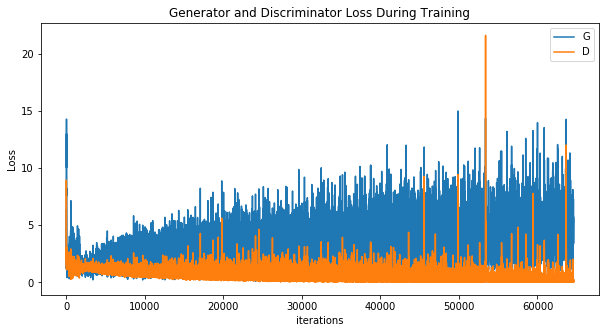

In [14]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

**Visualization of G’s progression**

Remember how we saved the generator’s output on the fixed_noise batch
after every epoch of training. Now, we can visualize the training
progression of G with an animation. Press the play button to start the
animation.




In [ ]:
#%%capture
fig = plt.figure(figsize=(128,128))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
ani.save('animation.gif', writer='imagemagick', fps=4)
HTML(ani.to_jshtml())

**Real Images vs. Fake Images**

Finally, lets take a look at some real images and fake images side by
side.




In [35]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(256,256))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:128], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

Where to Go Next
----------------

We have reached the end of our journey, but there are several places you
could go from here. You could:

-  Train for longer to see how good the results get
-  Modify this model to take a different dataset and possibly change the
   size of the images and the model architecture
-  Check out some other cool GAN projects
   `here <https://github.com/nashory/gans-awesome-applications>`__
-  Create GANs that generate
   `music <https://deepmind.com/blog/wavenet-generative-model-raw-audio/>`__




In [5]:
plt.figure(figsize=(128,128))
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

NameError: name 'img_list' is not defined

In [ ]:
#%%capture
fig = plt.figure(figsize=(132,132))
plt.axis("off")
ims = [[plt.imshow(np.transpose(vutils.make_grid(img_list[i].to(device)[:132,:132,:132], padding=2, normalize=True).cpu(),(1,2,0)), animated=True)] for i in range(2)]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
ani.save('4fpssingle.gif', writer='imagemagick', fps=4)
HTML(ani.to_jshtml())

In [ ]:
#plot image through time via epochs
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(vutils.make_grid(img_list[0].to(device)[:132,:132,:132], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()